My goal of this project is to develop a model with high interpretability that demonstrates relationship between each feature and ratings in a clear, easy way. Therefore, I will first explore models with the highest interpretability, then improve accuracy.

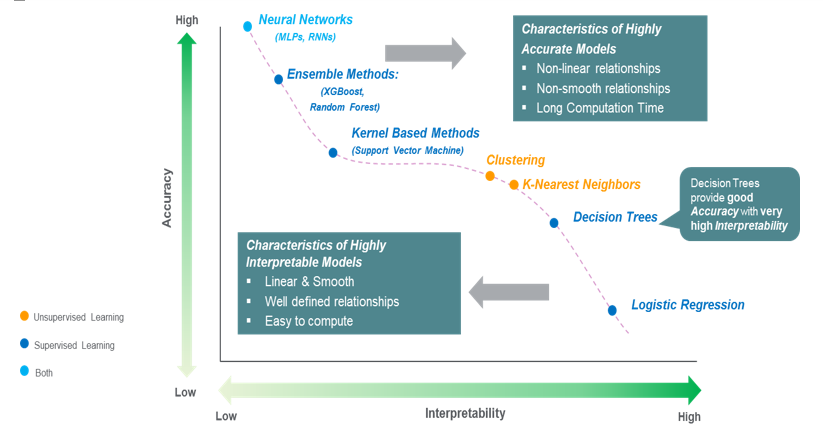

## Setup

### Import libraries

In [9]:
import json
import requests
import pandas as pd
import numpy as np
import pickle
import datetime, time
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [10]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import Lasso, Ridge, LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split
import sklearn.preprocessing as preprocessing
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
# from statsmodels.formula.api import add_constant

from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score, confusion_matrix, classification_report

from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

import os
os.environ['KMP_DUPLICATE_LIB_OK']='True' # to fix issues of kernel dying when running XGBClassifier
import xgboost as XGB

In [11]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

In [12]:
from sklearn.model_selection import KFold, StratifiedKFold, cross_val_score

In [13]:
from imblearn.over_sampling import SMOTE

In [14]:
from imblearn.under_sampling import RandomUnderSampler

In [15]:
import lime
import lime.lime_tabular

### Import data

In [19]:
df_merged = pickle.load(open("df_mergedv2.p", "rb"))

In [20]:
# convert ratings to intervals to prevent sciki-learn 
# to recognize the target variable to be continuous
df_merged['rating_cat'] = df_merged['rating'] * 2


# create binary target variable 'low_performer'
#  Rating equl to or below 3 (or rating_cat below 6): 1
#  Rating above 3 (or rating_cat above 6): 0
df_merged['low_performer'] = df_merged['rating'].apply(lambda x: 0 if x > 3 else 1)
df_merged[['rating', 'rating_cat', 'low_performer']].tail()

,rating,rating_cat,low_performer
6457,4.5,9.0,0
6458,4.0,8.0,0
6459,4.5,9.0,0
6460,4.5,9.0,0
6461,4.5,9.0,0


In [21]:
df_merged['low_performer'].value_counts(normalize=True)

0    0.89152
1    0.10848
Name: low_performer, dtype: float64

In [22]:
df_merged['rating'].value_counts(normalize=True)

4.0    0.422315
3.5    0.235067
4.5    0.191272
3.0    0.067317
5.0    0.042866
2.5    0.025070
2.0    0.010214
1.0    0.003869
1.5    0.002012
Name: rating, dtype: float64

In [23]:
42.2315 + 23.5067 + 19.1272

84.8654

In [24]:
# drop observations with missing price level
data = df_merged.dropna()
print('Number of features before one-hot-encoding: {}'.format(len(data.columns)))

# create dummy variables for neighborhoods
neighborhoods_dummies= pd.get_dummies(data['neighborhood'])
print('Number of neighborhoods: {}'.format(len(neighborhoods_dummies.columns)))

data = pd.concat([data, neighborhoods_dummies], axis=1)
print('Number of features after one-hot-encoding: {}'.format(len(data.columns)))

Number of features before one-hot-encoding: 320
Number of neighborhoods: 20
Number of features after one-hot-encoding: 340


### Set up functions

In [16]:
def plot_cm(target, labels, name, target_classes=3):
    '''
    Args:
       target : True labels of the target variable 
       labels : Predicted labels of the target variable
       name : String; Name of the model to be specified as the title of the plot
       target_classes : Number of classes in the target variable 
    
    Returns:
        Plots confusion metrix.
        
    '''
    cm = confusion_matrix(target, labels) 
    
    # Transform to df for easier plotting
    if target_classes == 3:
        cm_df = pd.DataFrame(cm,
                             index = ['3.5','4','4.5'], 
                             columns = ['3.5','4','4.5'])
    elif target_classes == 2:
        cm_df = pd.DataFrame(cm,
                             index = ['Average or Above Performers','Low Performers'], 
                             columns = ['Average or Above Performers','Low Performers'])
    else:
        cm_df = pd.DataFrame(cm,
                 index = ['3.5','4','4.5','5'], 
                 columns = ['3.5','4','4.5','5'])
        
    sns.heatmap(cm_df, annot=True, cmap='GnBu', vmax=200, annot_kws={"size": 14}, fmt='.3g')
    plt.title('{} \nAccuracy:{} \nWeighted F1 Score:{}'.format(name, 
                                        np.round(accuracy_score(target, labels),3),
                                        np.round(f1_score(target, labels, average='weighted'),3)),
               
             size=17)
    
    plt.ylabel('True label', size=15)
    plt.yticks(rotation=30) 
    plt.xlabel('Predicted label', size=15)

In [115]:
def plot_feature_importances(df, model, num=30, return_list=False):
    '''
    Args:
       df : Underlying datafarame of the model 
       model : Model to extract feature importances from
       num : Number of features to plot
       return_list : If true, returns the list of n features
    
    Returns:
        Plots a bar graph of feature importances of n features, in 
        in descending order of feature importances
        If return_list = Ture, returns the list of sorted n features.
        
    '''
    tree_feat_imp = dict(zip(df.columns, model.feature_importances_))
    data = sorted(tree_feat_imp.items(), key=lambda x: x[1], reverse=True)[:num]
        
    plt.barh([x[0] for x in data], [x[1] for x in data], align='center', color='darkolivegreen') 
    plt.xlabel("Feature importance", size=14)
    
    if return_list:
        return data

In [18]:
# set default formatting
sns.set(context='notebook', 
        style='white', 
        palette='colorblind',
        font='AppleMyungjo',
       
        font_scale=1.2, 
        color_codes=True, 
        rc={
             'axes.edgecolor': 'dimgray',
             'axes.facecolor': 'white',
             'axes.grid': False,
             'axes.labelcolor': 'dimgray',
             'axes.spines.right': False,
             'axes.spines.top': False,
             'figure.facecolor': 'white',
             'lines.solid_capstyle': 'round',
             'text.color': 'dimgray',
             'xtick.color': 'dimgray',
             'ytick.color': 'dimgray',
          })

## ANOVA

In [13]:
len(df_merged.columns)
len(data.columns)

340

In [14]:
# test = data[['rating_cat', 'cocktailbars', 'pickup', 'Upper West Side']]
# test_list = list(X.columns)
mainstream = ['italian', 'newamerican', 'breakfast_brunch', 'tradamerican', 
             'cocktailbars', 'pizza', 'bars', 'chinese', 'sandwiches', 'seafood', 
             'japanese', 'mexican', 'wine_bars', 'sushi', 'burgers', 'coffee', 
             'mediterranean', 'cafes', 'french', 'salad']
mainstream_str = []

for i in mainstream:
    if i == 'tex-mex':
        mainstream_str.append('C(Q("{}"))'.format(i))
    elif len(i.split()) == 1:
        mainstream_str.append('C({})'.format(i))
    else:
        mainstream_str.append('C(Q("{}"))'.format(i))

formula = 'rating_cat ~ ' + ' + '.join(mainstream_str)

lm = ols(formula, data).fit()
table = sm.stats.anova_lm(lm, typ=2)
print(table)

                          sum_sq      df          F        PR(>F)
C(italian)              0.124137     1.0   0.120888  7.280872e-01
C(newamerican)          0.152316     1.0   0.148329  7.001522e-01
C(breakfast_brunch)     0.457053     1.0   0.445090  5.047041e-01
C(tradamerican)        53.114084     1.0  51.723907  7.250583e-13
C(cocktailbars)        42.403031     1.0  41.293199  1.421602e-10
C(pizza)                2.412358     1.0   2.349218  1.254039e-01
C(bars)                 2.363200     1.0   2.301347  1.293199e-01
C(chinese)             30.481815     1.0  29.684002  5.308504e-08
C(sandwiches)           1.483676     1.0   1.444844  2.294094e-01
C(seafood)              0.554382     1.0   0.539872  4.625174e-01
C(japanese)             2.495490     1.0   2.430174  1.190778e-01
C(mexican)             22.893536     1.0  22.294334  2.397569e-06
C(wine_bars)           12.753856     1.0  12.420044  4.282380e-04
C(sushi)                2.917694     1.0   2.841328  9.192554e-02
C(burgers)

In [15]:
# droped LES (seems to be dropped during dedup process)
neighborhoods = ['Midtown West', 'Greenwich Village', 'East Harlem', 'Upper East Side', 'Midtown East',
                 'Gramercy', 'Little Italy', 'Chinatown', 'SoHo', 'Harlem',
                 'Upper West Side', 'Tribeca', 'Garment District', 'Stuyvesant Town', 'Financial District',
                 'Chelsea', 'Morningside Heights', 'Times Square', 'Murray Hill', 'East Village']

neighborhoods_str = []

for i in neighborhoods:
    if len(i.split()) == 1:
        neighborhoods_str.append('C({})'.format(i))
    else:
        neighborhoods_str.append('C(Q("{}"))'.format(i))

formula = 'rating_cat ~ ' + ' + '.join(neighborhoods_str)

lm = ols(formula, data).fit()
table = sm.stats.anova_lm(lm, typ=2)
print(table)

                                  sum_sq      df           F        PR(>F)
C(Q("Midtown West"))           82.771455     1.0   87.314798  1.318563e-20
C(Q("Greenwich Village"))     127.329895     1.0  134.319060  1.063098e-30
C(Q("East Harlem"))            38.533923     1.0   40.649058  1.971699e-10
C(Q("Upper East Side"))        98.579170     1.0  103.990201  3.349620e-24
C(Q("Midtown East"))           88.215099     1.0   93.057244  7.588013e-22
C(Gramercy)                     1.607112     1.0    1.695327  1.929552e-01
C(Q("Little Italy"))            0.083091     1.0    0.087652  7.671952e-01
C(Chinatown)                   48.601584     1.0   51.269335  9.119667e-13
C(SoHo)                        61.694707     1.0   65.081142  8.767214e-16
C(Harlem)                      30.422576     1.0   32.092478  1.545362e-08
C(Q("Upper West Side"))        11.743862     1.0   12.388485  4.355192e-04
C(Tribeca)                     10.263947     1.0   10.827337  1.006482e-03
C(Q("Garment District")) 

## Predict low performers vs. non-low performers

### Vanilla Models with Balanced Class Weight

#### Fitting the Model

In [117]:
to_drop = ['low_performer', 'rating_cat', 'rating', 'neighborhood',
           'index', 'alias', 'alias_x', 'alias_y', 'categories', 'display_phone',
           'distance', 'id', 'image_url', 'is_closed', 'location', 
           'name', 'phone', 'price', 'transactions', 'url', 
           'count', 'coordinates', 'categories_cln', 'Mon_start', 'Mon_end',
           'Tue_start', 'Tue_end', 'Wed_start', 'Wed_end', 'Thu_start',
           'Thu_end', 'Fri_start', 'Fri_end', 'Sat_start', 'Sat_end',
           'Sun_start', 'Sun_end']


y_low = data[['low_performer']].dropna()
X_low = data.drop(to_drop, axis=1)
print('Number of features after dropping un-wanted features: {}'.format(len(X_low.columns)))

# Perform test train split
X_low_train , X_low_test, y_low_train, y_low_test = train_test_split(X_low, y_low, 
                                                                     test_size=0.3, random_state=123)

scale = MinMaxScaler()
X_low_train_transformed = scale.fit_transform(X_low_train)
X_low_test_transformed = scale.transform(X_low_test)

Number of features after dropping un-wanted features: 303


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64, object were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [118]:
# running all feature
pipe_low_log = Pipeline([('clf', LogisticRegression(random_state=123, class_weight='balanced'))])
pipe_low_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123, class_weight='balanced'))])
pipe_low_forest = Pipeline([('clf', RandomForestClassifier(random_state=123, class_weight='balanced'))])
pipe_low_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_low_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_low_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_low = [pipe_low_log, pipe_low_tree, pipe_low_forest, 
                 pipe_low_adaboost, pipe_low_gbt, pipe_low_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_low:
    print(pipe)
    pipe.fit(X_low_train_transformed, np.ravel(y_low_train))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators='warn', n_jobs=None, oob_score=False,
            random_state=123, verbose=0, warm_start=False))])


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=1.0, n_estimators=50, random_state=123))])
Pipeline(memory=None,
     steps=[('clf', GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_...    subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       see

#### Results

In [119]:
# Compare accuracies & f1 score
pipeline_low_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_low):
    print('%s : %.3f' % (pipeline_low_names[index], val.score(X_low_test_transformed, y_low_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_low):
    print('%s : %.3f' % (pipeline_low_names[index],
                         f1_score(y_low_test, val.predict(X_low_test_transformed), average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.770
Decision Tree : 0.839
Random Forest : 0.905
Adaboost : 0.904
Gradient Boosting : 0.913
XGBoost : 0.908

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.810
Decision Tree : 0.847
Random Forest : 0.881
Adaboost : 0.889
Gradient Boosting : 0.892
XGBoost : 0.885


In [120]:
for index, pipe in enumerate(pipelines_low):
    print('----------------------------------------')
    print(pipeline_low_names[index])
    print('----------------------------------------')
    print(classification_report(y_low_test, pipe.predict(X_low_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.78      0.86      1473
           1       0.26      0.69      0.38       168

   micro avg       0.77      0.77      0.77      1641
   macro avg       0.61      0.73      0.62      1641
weighted avg       0.89      0.77      0.81      1641

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.90      0.91      1473
           1       0.27      0.35      0.31       168

   micro avg       0.84      0.84      0.84      1641
   macro avg       0.60      0.62      0.61      1641
weighted avg       0.86      0.84      0.85      1641

----------------------------------------
Random Forest
----------------------------------------
              precision    recall  f1-score   suppor

#### Feature Importance

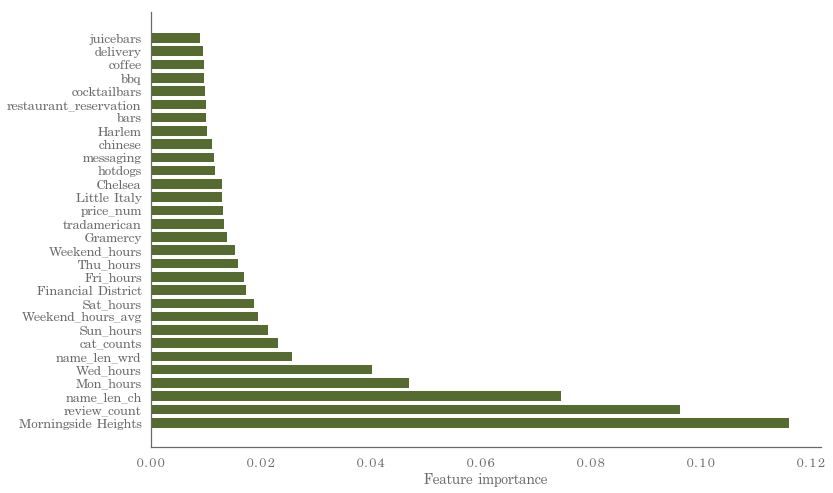

In [121]:
# Vanilla Decision Tree Classifier (Binary Labels)
plt.figure(figsize=(12,8))
tree_low = plot_feature_importances(X_low, pipelines_low[1].steps[0][1], return_list=True)

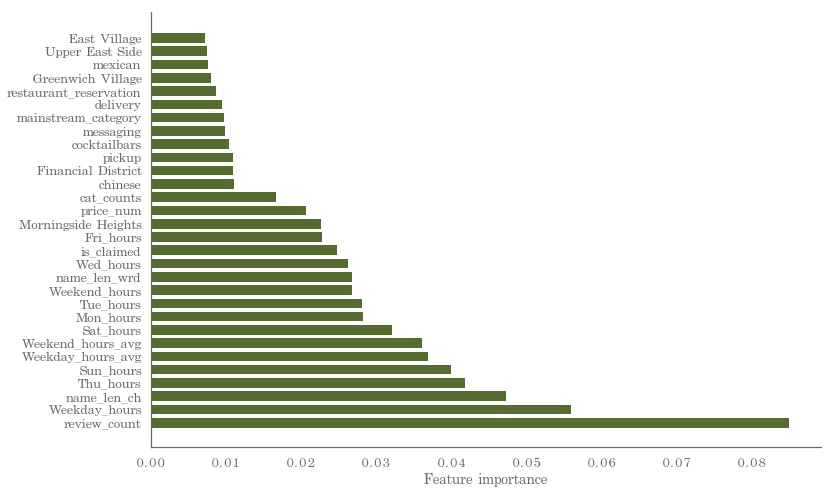

In [122]:
# Vanilla Random Forest Classifier (Binary Labels)
plt.figure(figsize=(12,8))
forest_low = plot_feature_importances(X_low, pipelines_low[2].steps[0][1], return_list=True)

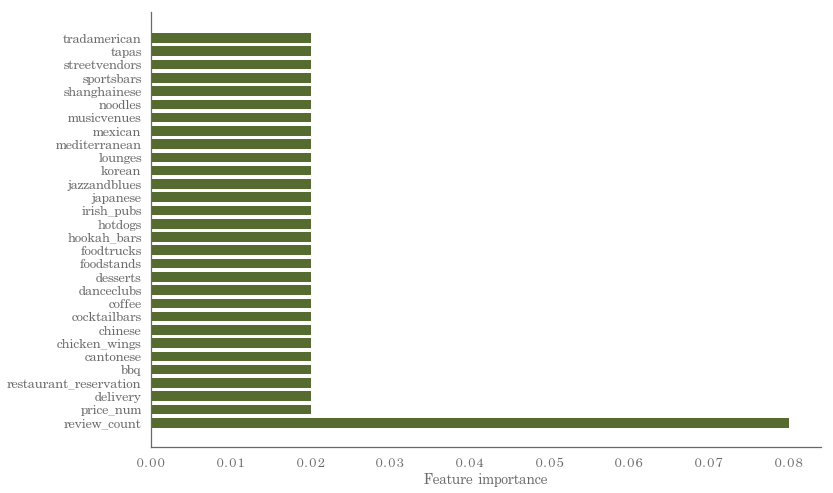

In [123]:
# Vanilla Adaboost Classifier (Binary Labels)
plt.figure(figsize=(12,8))
adaboost_low = plot_feature_importances(X_low, pipelines_low[3].steps[0][1], return_list=True)

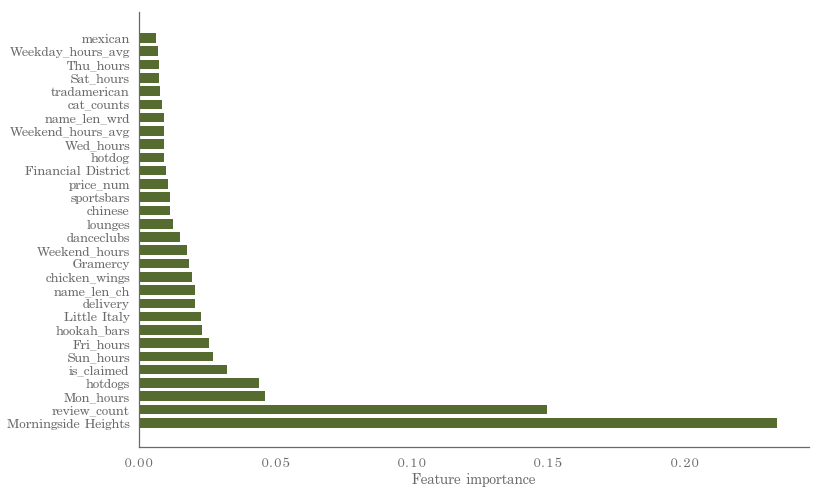

In [124]:
# Vanilla Gradient Boosting Classifier (Binary Labels)
plt.figure(figsize=(12,8))
gbt_low = plot_feature_importances(X_low, pipelines_low[4].steps[0][1], return_list=True)

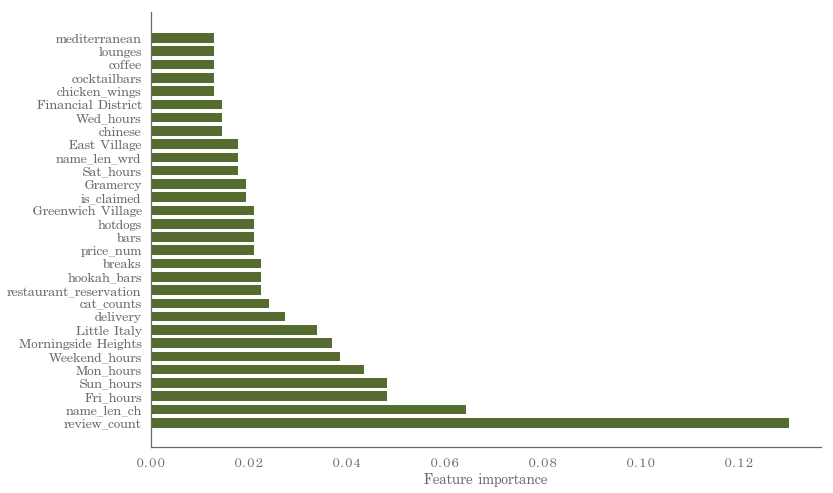

In [125]:
# Vanilla XGBoosting Classifier (Binary Labels)
plt.figure(figsize=(12,8))
xgb_low = plot_feature_importances(X_low, pipelines_low[5].steps[0][1], return_list=True)

### Vanilla Models with Balanced Class Weight & Less Features

#### Fitting the Model

In [126]:
tree_low[0][0]

'Morningside Heights'

In [127]:
vanilla_low_features = []
vanilla_low = [tree_low, forest_low, adaboost_low, gbt_low, xgb_low]
for model in vanilla_low:
    for i in range(len(model)):
        feature = model[i][0]
        if feature not in vanilla_low_features:
            vanilla_low_features.append(feature)

print(len(vanilla_low_features))
print(vanilla_low_features)

61
['Morningside Heights', 'review_count', 'name_len_ch', 'Mon_hours', 'Wed_hours', 'name_len_wrd', 'cat_counts', 'Sun_hours', 'Weekend_hours_avg', 'Sat_hours', 'Financial District', 'Fri_hours', 'Thu_hours', 'Weekend_hours', 'Gramercy', 'tradamerican', 'price_num', 'Little Italy', 'Chelsea', 'hotdogs', 'messaging', 'chinese', 'Harlem', 'bars', 'restaurant_reservation', 'cocktailbars', 'bbq', 'coffee', 'delivery', 'juicebars', 'Weekday_hours', 'Weekday_hours_avg', 'Tue_hours', 'is_claimed', 'pickup', 'mainstream_category', 'Greenwich Village', 'mexican', 'Upper East Side', 'East Village', 'cantonese', 'chicken_wings', 'danceclubs', 'desserts', 'foodstands', 'foodtrucks', 'hookah_bars', 'irish_pubs', 'japanese', 'jazzandblues', 'korean', 'lounges', 'mediterranean', 'musicvenues', 'noodles', 'shanghainese', 'sportsbars', 'streetvendors', 'tapas', 'hotdog', 'breaks']


In [128]:
# Too many features regarding business hours -- only keep Weekend_hours and Weekday_hours

to_drop = ['Mon_hours', 'Tue_hours', 'Wed_hours', 'Thu_hours',
           'Fri_hours', 'Sat_hours', 'Sun_hours', 'Weekend_hours_avg', 'Weekday_hours_avg']

y_low_feat = data[['low_performer']].dropna()
X_low_feat = data[vanilla_low_features].drop(to_drop, axis=1)
print('Number of features after dropping un-wanted features: {}'.format(len(X_low_feat.columns)))

# Perform test train split
X_low_feat_train, X_low_feat_test, y_low_feat_train, y_low_feat_test = train_test_split(X_low_feat, 
                                                                                         y_low_feat, 
                                                                     test_size=0.3, random_state=123)

scale = MinMaxScaler()
X_low_feat_train_transformed = scale.fit_transform(X_low_feat_train)
X_low_feat_test_transformed = scale.transform(X_low_feat_test)

Number of features after dropping un-wanted features: 52


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64, object were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [129]:
# running all feature
pipe_low_feat_log = Pipeline([('clf', LogisticRegression(random_state=123, class_weight='balanced'))])
pipe_low_feat_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123, class_weight='balanced'))])
pipe_low_feat_forest = Pipeline([('clf', RandomForestClassifier(random_state=123, class_weight='balanced'))])
pipe_low_feat_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_low_feat_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_low_feat_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_low_feat = [pipe_low_feat_log, pipe_low_feat_tree, pipe_low_feat_forest, 
                 pipe_low_feat_adaboost, pipe_low_feat_gbt, pipe_low_feat_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_low_feat:
    print(pipe)
    pipe.fit(X_low_feat_train_transformed, np.ravel(y_low_feat_train))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_...    subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=True, subsample=1))])


#### Results

In [130]:
# Compare accuracies & f1 score
pipeline_low_feat_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_low_feat):
    print('%s : %.3f' % (pipeline_low_feat_names[index], val.score(X_low_feat_test_transformed, 
                                                                   y_low_feat_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_low_feat):
    print('%s : %.3f' % (pipeline_low_feat_names[index],
                         f1_score(y_low_feat_test, val.predict(X_low_feat_test_transformed), 
                                  average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.752
Decision Tree : 0.848
Random Forest : 0.906
Adaboost : 0.903
Gradient Boosting : 0.912
XGBoost : 0.910

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.796
Decision Tree : 0.852
Random Forest : 0.880
Adaboost : 0.888
Gradient Boosting : 0.893
XGBoost : 0.888


In [131]:
for index, pipe in enumerate(pipelines_low_feat):
    print('----------------------------------------')
    print(pipeline_low_feat_names[index])
    print('----------------------------------------')
    print(classification_report(y_low_feat_test, pipe.predict(X_low_feat_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.76      0.85      1473
           1       0.24      0.65      0.35       168

   micro avg       0.75      0.75      0.75      1641
   macro avg       0.60      0.71      0.60      1641
weighted avg       0.88      0.75      0.80      1641

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.91      0.91      1473
           1       0.28      0.32      0.30       168

   micro avg       0.85      0.85      0.85      1641
   macro avg       0.60      0.61      0.61      1641
weighted avg       0.86      0.85      0.85      1641

----------------------------------------
Random Forest
----------------------------------------
              precision    recall  f1-score   suppor

#### Feature Importance

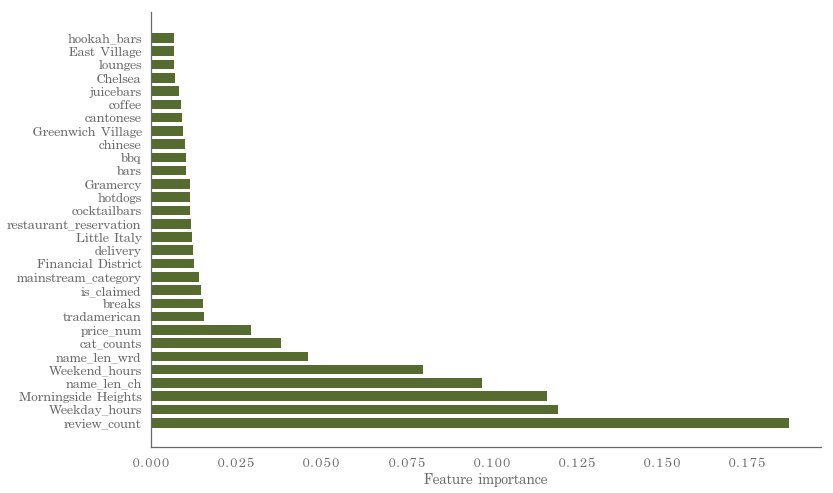

In [132]:
# Vanilla Decision Tree Classifier (Binary Labels)
plt.figure(figsize=(12,8))
tree_low_feat = plot_feature_importances(X_low_feat, pipelines_low_feat[1].steps[0][1], return_list=True)

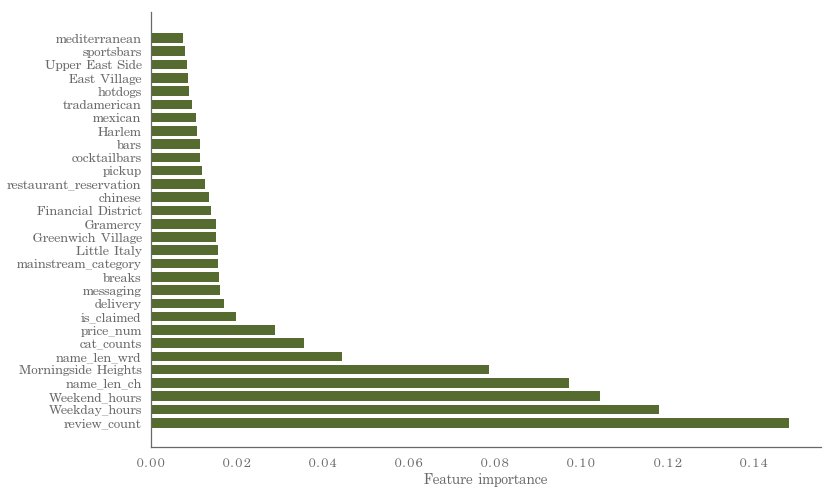

In [133]:
# Vanilla Random Forest Classifier (Binary Labels)
plt.figure(figsize=(12,8))
forest_low_feat = plot_feature_importances(X_low_feat, pipelines_low_feat[2].steps[0][1], return_list=True)

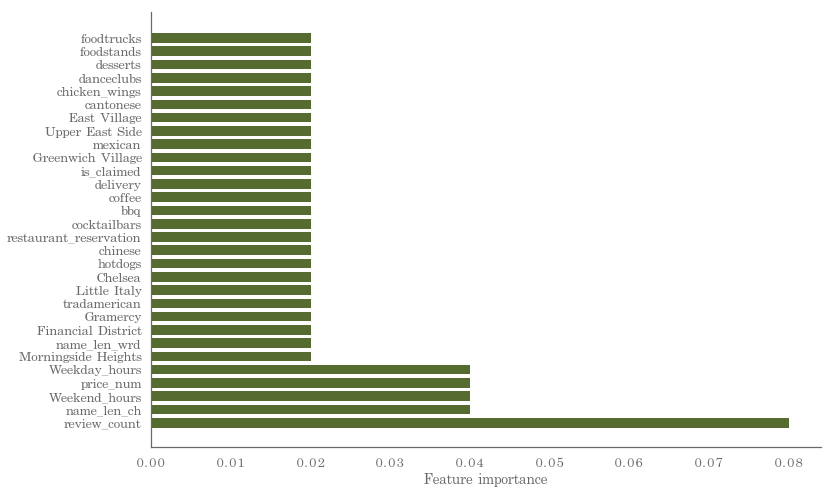

In [134]:
# Vanilla Adaboost Classifier (Binary Labels)
plt.figure(figsize=(12,8))
adaboost_low_feat = plot_feature_importances(X_low_feat, pipelines_low_feat[3].steps[0][1], return_list=True)

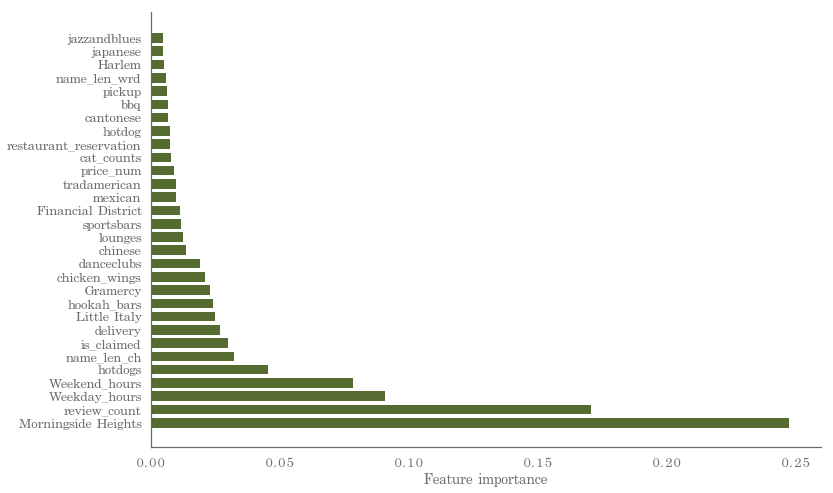

In [135]:
# Vanilla Gradient Boosting Classifier (Binary Labels)
plt.figure(figsize=(12,8))
gbt_low_feat = plot_feature_importances(X_low_feat, pipelines_low_feat[4].steps[0][1], return_list=True)

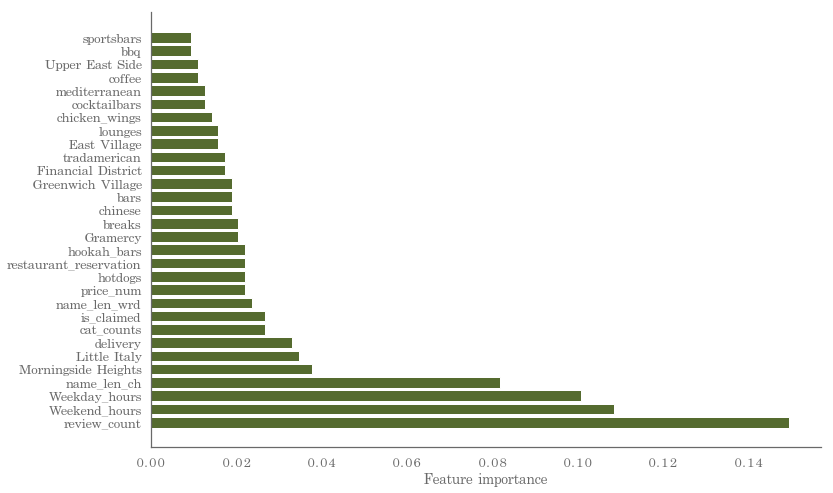

In [136]:
# Vanilla XGBoosting Classifier (Binary Labels)
plt.figure(figsize=(12,8))
xgb_low_feat = plot_feature_importances(X_low_feat, pipelines_low_feat[5].steps[0][1], return_list=True)

### Vanilla Models with Balanced Class Weight & Less Features, Excluding 5-star Ratings

#### Fitting the Model

In [137]:
vanilla_low_features = []
vanilla_low = [tree_low, forest_low, adaboost_low, gbt_low, xgb_low]
for model in vanilla_low:
    for i in range(len(model)):
        feature = model[i][0]
        if feature not in vanilla_low_features:
            vanilla_low_features.append(feature)

print(len(vanilla_low_features))
print(vanilla_low_features)

61
['Morningside Heights', 'review_count', 'name_len_ch', 'Mon_hours', 'Wed_hours', 'name_len_wrd', 'cat_counts', 'Sun_hours', 'Weekend_hours_avg', 'Sat_hours', 'Financial District', 'Fri_hours', 'Thu_hours', 'Weekend_hours', 'Gramercy', 'tradamerican', 'price_num', 'Little Italy', 'Chelsea', 'hotdogs', 'messaging', 'chinese', 'Harlem', 'bars', 'restaurant_reservation', 'cocktailbars', 'bbq', 'coffee', 'delivery', 'juicebars', 'Weekday_hours', 'Weekday_hours_avg', 'Tue_hours', 'is_claimed', 'pickup', 'mainstream_category', 'Greenwich Village', 'mexican', 'Upper East Side', 'East Village', 'cantonese', 'chicken_wings', 'danceclubs', 'desserts', 'foodstands', 'foodtrucks', 'hookah_bars', 'irish_pubs', 'japanese', 'jazzandblues', 'korean', 'lounges', 'mediterranean', 'musicvenues', 'noodles', 'shanghainese', 'sportsbars', 'streetvendors', 'tapas', 'hotdog', 'breaks']


In [138]:
data['rating'].value_counts()

4.0    2455
3.5    1405
4.5     969
3.0     386
2.5     136
5.0      63
2.0      45
1.5       8
1.0       3
Name: rating, dtype: int64

In [139]:
data['rating'].value_counts(normalize=True)

4.0    0.448812
3.5    0.256856
4.5    0.177148
3.0    0.070567
2.5    0.024863
5.0    0.011517
2.0    0.008227
1.5    0.001463
1.0    0.000548
Name: rating, dtype: float64

In [140]:
data_excl5 = data.loc[data['rating'] != 5]
data_excl5['rating'].value_counts()

4.0    2455
3.5    1405
4.5     969
3.0     386
2.5     136
2.0      45
1.5       8
1.0       3
Name: rating, dtype: int64

In [141]:
# Too many features regarding business hours -- only keep Weekend_hours and Weekday_hours
# See if performance improves when excluding restaurants with 5 star ratings 
to_drop = ['Mon_hours', 'Tue_hours', 'Wed_hours', 'Thu_hours',
           'Fri_hours', 'Sat_hours', 'Sun_hours', 'Weekend_hours_avg', 'Weekday_hours_avg']

y_low_feat_excl5 = data_excl5[['low_performer']].dropna()
X_low_feat_excl5 = data_excl5[vanilla_low_features].drop(to_drop, axis=1)
print('Number of features after dropping un-wanted features: {}'.format(len(X_low_feat_excl5.columns)))

# Perform test train split
X_low_feat_excl5_train, X_low_feat_excl5_test, y_low_feat_excl5_train, y_low_feat_excl5_test = train_test_split(
    X_low_feat_excl5, y_low_feat_excl5, test_size=0.3, random_state=123)

scale = MinMaxScaler()
X_low_feat_excl5_train_transformed = scale.fit_transform(X_low_feat_excl5_train)
X_low_feat_excl5_test_transformed = scale.transform(X_low_feat_excl5_test)

Number of features after dropping un-wanted features: 52


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64, object were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [142]:
# running all feature
pipe_low_feat_excl5_log = Pipeline([('clf', LogisticRegression(random_state=123, 
                                                               class_weight='balanced'))])
pipe_low_feat_excl5_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123, 
                                                                    class_weight='balanced'))])
pipe_low_feat_excl5_forest = Pipeline([('clf', RandomForestClassifier(random_state=123, 
                                                                      class_weight='balanced'))])
pipe_low_feat_excl5_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_low_feat_excl5_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_low_feat_excl5_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_low_feat_excl5 = [pipe_low_feat_excl5_log, pipe_low_feat_excl5_tree, pipe_low_feat_excl5_forest, 
                 pipe_low_feat_excl5_adaboost, pipe_low_feat_excl5_gbt, pipe_low_feat_excl5_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_low_feat_excl5:
    print(pipe)
    pipe.fit(X_low_feat_excl5_train_transformed, np.ravel(y_low_feat_excl5_train))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators='warn', n_jobs=None, oob_score=False,
            random_state=123, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=1.0, n_estimators=50, random_state=123))])


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_...    subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=True, subsample=1))])


#### Results

In [143]:
# Compare accuracies & f1 score
pipeline_low_feat_excl5_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_low_feat_excl5):
    print('%s : %.3f' % (pipeline_low_feat_excl5_names[index], val.score(X_low_feat_excl5_test_transformed, 
                                                                   y_low_feat_excl5_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_low_feat_excl5):
    print('%s : %.3f' % (pipeline_low_feat_excl5_names[index],
                         f1_score(y_low_feat_excl5_test, val.predict(X_low_feat_excl5_test_transformed), 
                                  average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.757
Decision Tree : 0.859
Random Forest : 0.909
Adaboost : 0.908
Gradient Boosting : 0.916
XGBoost : 0.916

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.802
Decision Tree : 0.863
Random Forest : 0.887
Adaboost : 0.892
Gradient Boosting : 0.897
XGBoost : 0.893


In [144]:
for index, pipe in enumerate(pipelines_low_feat_excl5):
    print('----------------------------------------')
    print(pipeline_low_feat_excl5_names[index])
    print('----------------------------------------')
    print(classification_report(y_low_feat_excl5_test, pipe.predict(X_low_feat_excl5_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.76      0.85      1461
           1       0.25      0.73      0.37       162

   micro avg       0.76      0.76      0.76      1623
   macro avg       0.61      0.74      0.61      1623
weighted avg       0.89      0.76      0.80      1623

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.91      0.92      1461
           1       0.32      0.36      0.34       162

   micro avg       0.86      0.86      0.86      1623
   macro avg       0.62      0.64      0.63      1623
weighted avg       0.87      0.86      0.86      1623

----------------------------------------
Random Forest
----------------------------------------
              precision    recall  f1-score   suppor

#### Feature Importance

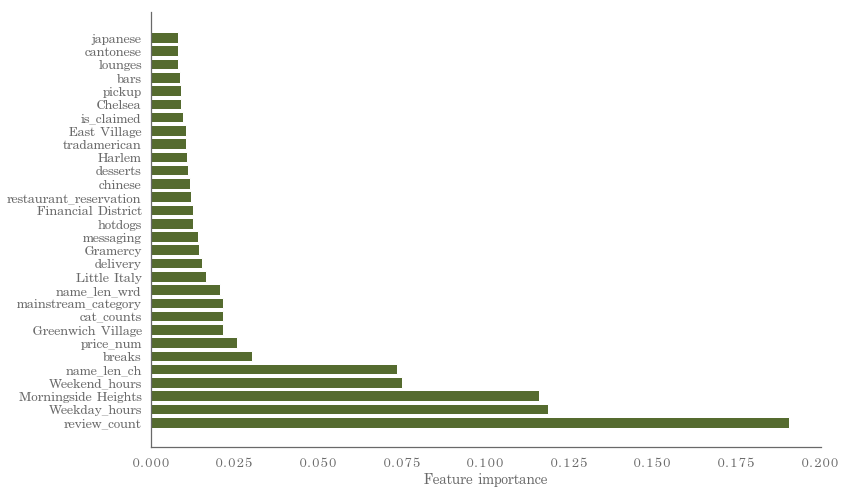

In [145]:
# Vanilla Decision Tree Classifier (Binary Labels)
plt.figure(figsize=(12,8))
tree_low_feat_excl5 = plot_feature_importances(X_low_feat_excl5, 
                                               pipelines_low_feat_excl5[1].steps[0][1], return_list=True)

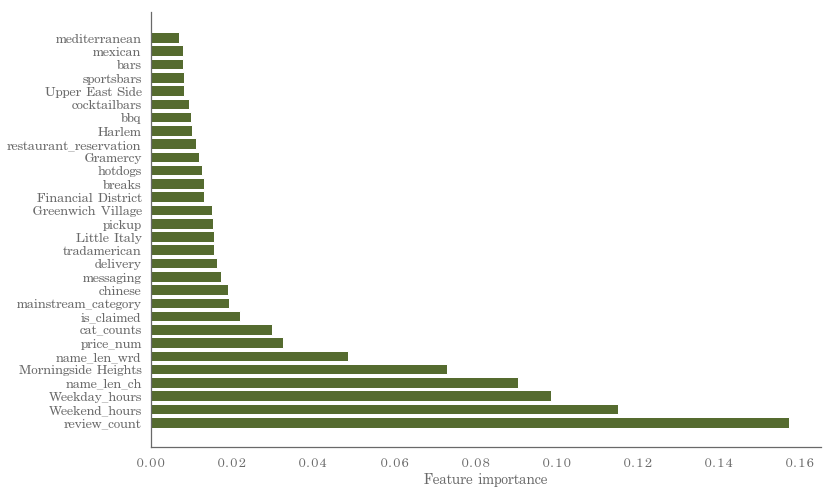

In [146]:
# Vanilla Random Forest Classifier (Binary Labels)
plt.figure(figsize=(12,8))
forest_low_feat_excl5 = plot_feature_importances(X_low_feat_excl5, 
                                                 pipelines_low_feat_excl5[2].steps[0][1], return_list=True)

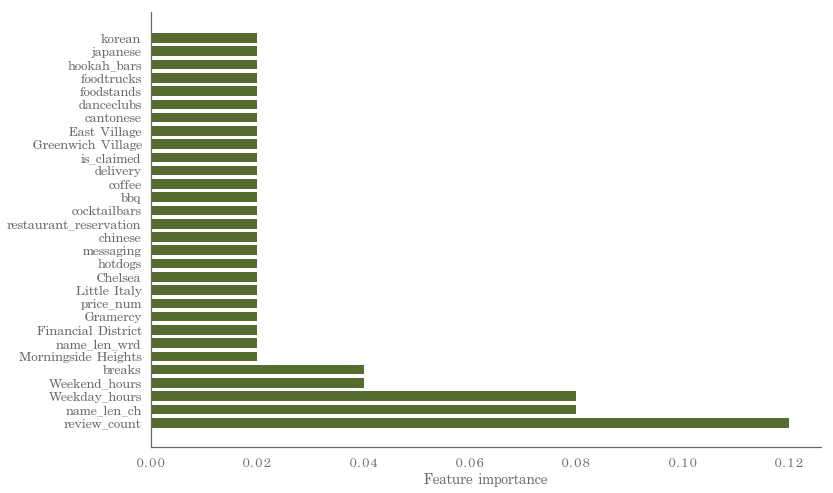

In [147]:
# Vanilla Adaboost Classifier (Binary Labels)
plt.figure(figsize=(12,8))
adaboost_low_feat_excl5 = plot_feature_importances(X_low_feat_excl5, 
                                                   pipelines_low_feat_excl5[3].steps[0][1], return_list=True)

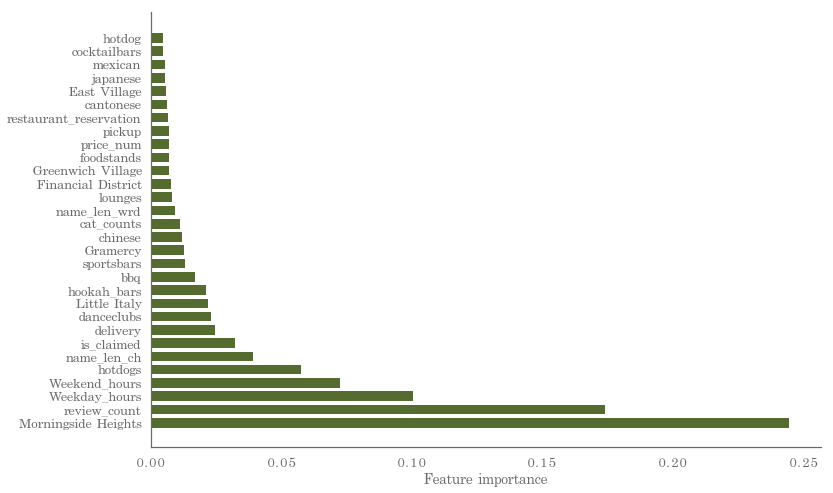

In [148]:
# Vanilla Gradient Boosting Classifier (Binary Labels)
plt.figure(figsize=(12,8))
gbt_low_feat_excl5 = plot_feature_importances(X_low_feat_excl5, 
                                              pipelines_low_feat_excl5[4].steps[0][1], return_list=True)

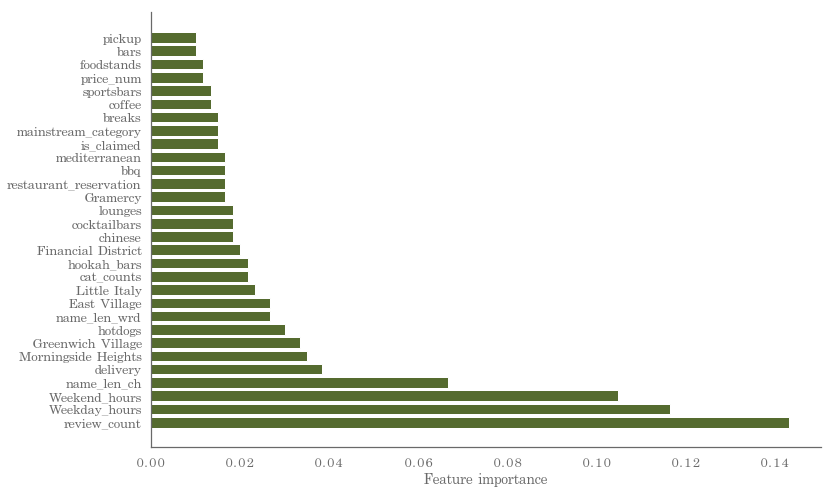

In [149]:
# Vanilla XGBoosting Classifier (Binary Labels)
plt.figure(figsize=(12,8))
xgb_low_feat_excl5 = plot_feature_importances(X_low_feat_excl5, 
                                              pipelines_low_feat_excl5[5].steps[0][1], return_list=True)

## Model non-low performers (Excluding 5-star Ratings)

### Vanilla Models with Balanced Class Weight, Excluding 5-star Ratings

#### Fitting the Model

In [150]:
data_avg_excl5 = data.loc[(data['low_performer'] == 0) & (data['rating'] != 5)]
data_avg_excl5['rating'].value_counts()

4.0    2455
3.5    1405
4.5     969
Name: rating, dtype: int64

In [151]:
to_drop = ['low_performer', 'rating_cat', 'rating', 'neighborhood',
           'index', 'alias','alias_x', 'alias_y', 'categories', 'display_phone',
           'distance', 'id', 'image_url', 'is_closed', 'location', 
           'name', 'phone', 'price', 'transactions', 'url', 
           'count', 'coordinates', 'categories_cln', 'Mon_start', 'Mon_end',
           'Tue_start', 'Tue_end', 'Wed_start', 'Wed_end', 'Thu_start',
           'Thu_end', 'Fri_start', 'Fri_end', 'Sat_start', 'Sat_end',
           'Sun_start', 'Sun_end']


y_avg = data_avg_excl5[['rating_cat']].dropna()
X_avg = data_avg_excl5.drop(to_drop, axis=1)
print('Number of features after dropping un-wanted features: {}'.format(len(X_avg.columns)))

# Perform test train split
X_avg_train , X_avg_test, y_avg_train, y_avg_test = train_test_split(X_avg, y_avg, 
                                                                     test_size=0.3, random_state=123)

scale = MinMaxScaler()
X_avg_train_transformed = scale.fit_transform(X_avg_train)
X_avg_test_transformed = scale.transform(X_avg_test)

Number of features after dropping un-wanted features: 303


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64, object were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [152]:
# running all feature
pipe_avg_log = Pipeline([('clf', LogisticRegression(random_state=123, class_weight='balanced'))])
pipe_avg_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123, class_weight='balanced'))])
pipe_avg_forest = Pipeline([('clf', RandomForestClassifier(random_state=123, class_weight='balanced'))])
pipe_avg_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_avg_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_avg_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_avg = [pipe_avg_log, pipe_avg_tree, pipe_avg_forest, 
                 pipe_avg_adaboost, pipe_avg_gbt, pipe_avg_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_avg:
    print(pipe)
    pipe.fit(X_avg_train_transformed, np.ravel(y_avg_train))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=1.0, n_estimators=50, random_state=123))])
Pipeline(memory=None,
     steps=[('clf', GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_...    subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       see

#### Results

In [153]:
# Compare accuracies & f1 score
pipeline_avg_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg):
    print('%s : %.3f' % (pipeline_avg_names[index], val.score(X_avg_test_transformed, y_avg_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg):
    print('%s : %.3f' % (pipeline_avg_names[index],
                         f1_score(y_avg_test, val.predict(X_avg_test_transformed), average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.478
Decision Tree : 0.416
Random Forest : 0.455
Adaboost : 0.520
Gradient Boosting : 0.523
XGBoost : 0.519

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.478
Decision Tree : 0.417
Random Forest : 0.424
Adaboost : 0.474
Gradient Boosting : 0.457
XGBoost : 0.445


In [154]:
for index, pipe in enumerate(pipelines_avg):
    print('----------------------------------------')
    print(pipeline_avg_names[index])
    print('----------------------------------------')
    print(classification_report(y_avg_test, pipe.predict(X_avg_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.40      0.42      0.41       395
         8.0       0.54      0.55      0.55       736
         9.0       0.41      0.38      0.39       318

   micro avg       0.48      0.48      0.48      1449
   macro avg       0.45      0.45      0.45      1449
weighted avg       0.48      0.48      0.48      1449

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.32      0.34      0.33       395
         8.0       0.51      0.50      0.51       736
         9.0       0.32      0.31      0.32       318

   micro avg       0.42      0.42      0.42      1449
   macro avg       0.38      0.38      0.38      1449
weighted avg       0.42      0.42      0.42      1449

----------------------------------------

#### Feature Importance & Confusion Matrix

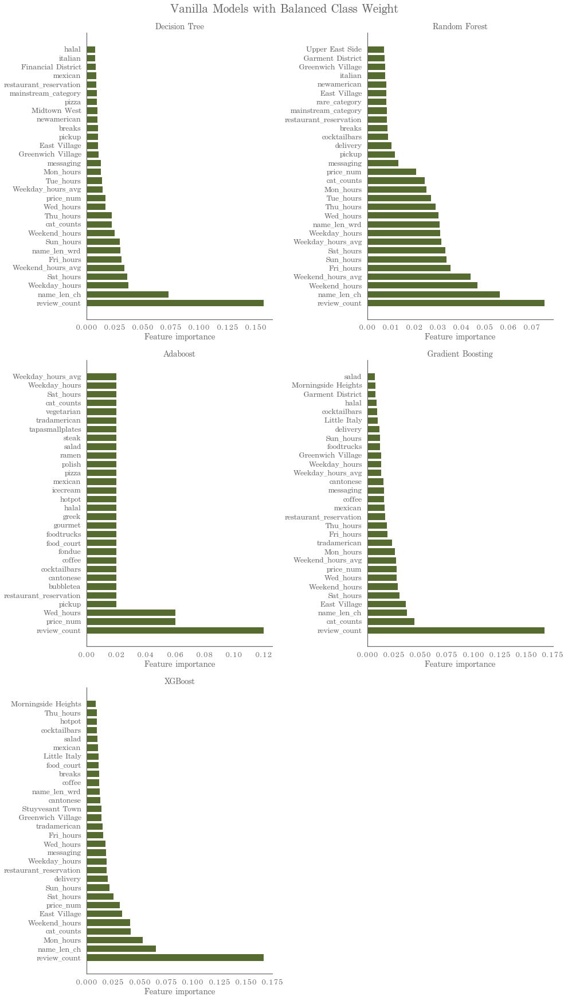

In [155]:
# feature importance
fig, ax = plt.subplots(3, 2, figsize=(14,24))
# vanilla_avg = [tree_avg, forest_avg, adaboost_avg, gbt_avg, xgb_avg]
vanilla_avg = []
for index in range(len(pipelines_avg)-1):
    plt.subplot(3,2,index+1)
    vanilla_avg.append(plot_feature_importances(X_avg, 
                                                pipelines_avg[1+index].steps[0][1],
                                                return_list=True))
    plt.title('{}'.format(pipeline_avg_names[1+index]), size=14)
    
fig.tight_layout()
fig.delaxes(ax[-1,-1])
plt.suptitle('Vanilla Models with Balanced Class Weight', size=20, y=1.01, weight='bold')
plt.show()

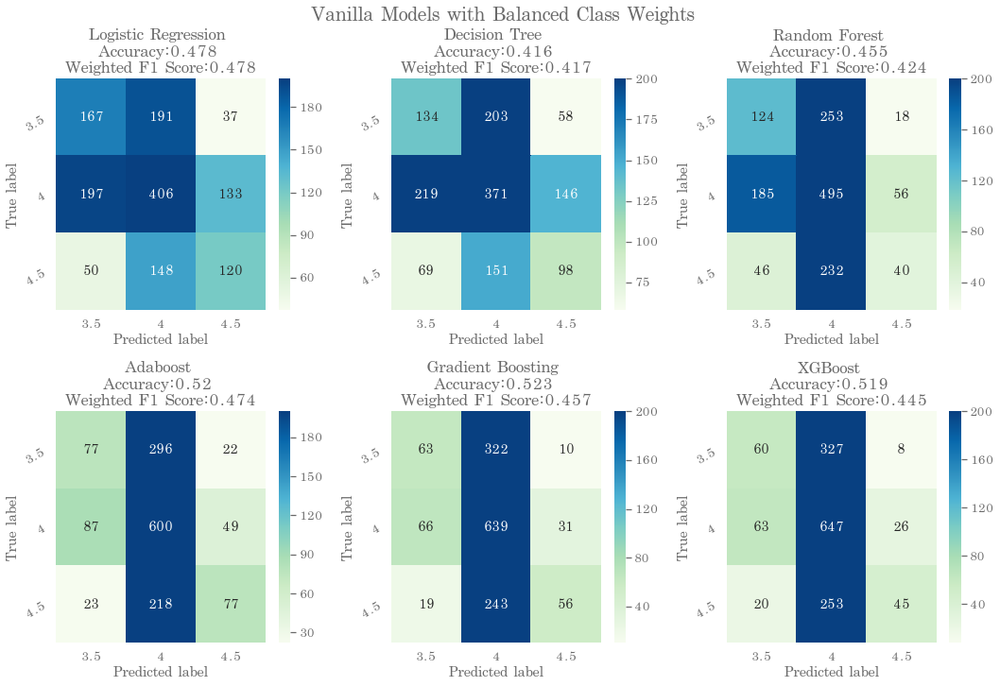

In [156]:
# confusion matrix
fig, ax = plt.subplots(2, 3, figsize=(15,10))

for index, val in enumerate(pipelines_avg):
    plt.subplot(2,3,index+1)
    plot_cm(target = y_avg_test, 
            labels = val.predict(X_avg_test_transformed),
            name = pipeline_avg_names[index],
            target_classes=3)
    
fig.tight_layout()
plt.suptitle('Vanilla Models with Balanced Class Weights', size=20, y=1.01, weight='bold')
plt.show()

### Vanilla Models with Balanced Class Weight & Less Features, Excluding 5-star Ratings

#### Fitting the Model

In [157]:
vanilla_avg_features = []
for model in vanilla_avg:
    for i in range(len(model)):
        feature = model[i][0]
        if feature not in vanilla_avg_features:
            vanilla_avg_features.append(feature)

print(len(vanilla_avg_features))
print(vanilla_avg_features)

55
['review_count', 'name_len_ch', 'Weekday_hours', 'Sat_hours', 'Weekend_hours_avg', 'Fri_hours', 'name_len_wrd', 'Sun_hours', 'Weekend_hours', 'cat_counts', 'Thu_hours', 'Wed_hours', 'price_num', 'Weekday_hours_avg', 'Tue_hours', 'Mon_hours', 'messaging', 'Greenwich Village', 'East Village', 'pickup', 'breaks', 'newamerican', 'Midtown West', 'pizza', 'mainstream_category', 'restaurant_reservation', 'mexican', 'Financial District', 'italian', 'halal', 'delivery', 'cocktailbars', 'rare_category', 'Garment District', 'Upper East Side', 'bubbletea', 'cantonese', 'coffee', 'fondue', 'food_court', 'foodtrucks', 'gourmet', 'greek', 'hotpot', 'icecream', 'polish', 'ramen', 'salad', 'steak', 'tapasmallplates', 'tradamerican', 'vegetarian', 'Little Italy', 'Morningside Heights', 'Stuyvesant Town']


In [158]:
len(data)

5470

In [159]:
# Too many features regarding business hours -- only keep Weekend_hours and Weekday_hours
# See if performance improves when excluding restaurants with 5 star ratings 
to_drop = ['Mon_hours', 'Tue_hours', 'Wed_hours', 'Thu_hours',
           'Fri_hours', 'Sat_hours', 'Sun_hours', 'Weekend_hours_avg', 'Weekday_hours_avg']

y_avg_feat = data_avg_excl5[['rating_cat']].dropna()
X_avg_feat = data_avg_excl5[vanilla_avg_features].drop(to_drop, axis=1)
print('Number of features after dropping un-wanted features: {}'.format(len(X_avg_feat.columns)))

# Perform test train split
X_avg_feat_train, X_avg_feat_test, y_avg_feat_train, y_avg_feat_test = train_test_split(
    X_avg_feat, y_avg_feat, test_size=0.3, random_state=123)

scale = MinMaxScaler()
X_avg_feat_train_transformed = scale.fit_transform(X_avg_feat_train)
X_avg_feat_test_transformed = scale.transform(X_avg_feat_test)

Number of features after dropping un-wanted features: 46


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64, object were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [160]:
# running all feature
pipe_avg_feat_log = Pipeline([('clf', LogisticRegression(random_state=123, 
                                                               class_weight='balanced'))])
pipe_avg_feat_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123, 
                                                                    class_weight='balanced'))])
pipe_avg_feat_forest = Pipeline([('clf', RandomForestClassifier(random_state=123, 
                                                                      class_weight='balanced'))])
pipe_avg_feat_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_avg_feat_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_avg_feat_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_avg_feat = [pipe_avg_feat_log, pipe_avg_feat_tree, pipe_avg_feat_forest, 
                 pipe_avg_feat_adaboost, pipe_avg_feat_gbt, pipe_avg_feat_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_avg_feat:
    print(pipe)
    pipe.fit(X_avg_feat_train_transformed, np.ravel(y_avg_feat_train))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=1.0, n_estimators=50, random_state=123))])
Pipeline(memory=None,
     steps=[('clf', GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_...    subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       see

#### Results

In [161]:
# Compare accuracies & f1 score
pipeline_avg_feat_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg_feat):
    print('%s : %.3f' % (pipeline_avg_feat_names[index], val.score(X_avg_feat_test_transformed, 
                                                                   y_avg_feat_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg_feat):
    print('%s : %.3f' % (pipeline_avg_feat_names[index],
                         f1_score(y_avg_feat_test, val.predict(X_avg_feat_test_transformed), 
                                  average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.460
Decision Tree : 0.440
Random Forest : 0.484
Adaboost : 0.525
Gradient Boosting : 0.525
XGBoost : 0.529

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.457
Decision Tree : 0.438
Random Forest : 0.467
Adaboost : 0.472
Gradient Boosting : 0.467
XGBoost : 0.462


In [162]:
for index, pipe in enumerate(pipelines_avg_feat):
    print('----------------------------------------')
    print(pipeline_avg_feat_names[index])
    print('----------------------------------------')
    print(classification_report(y_avg_feat_test, pipe.predict(X_avg_feat_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.38      0.38      0.38       395
         8.0       0.53      0.56      0.55       736
         9.0       0.37      0.32      0.34       318

   micro avg       0.46      0.46      0.46      1449
   macro avg       0.43      0.42      0.42      1449
weighted avg       0.46      0.46      0.46      1449

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.37      0.40      0.39       395
         8.0       0.54      0.54      0.54       736
         9.0       0.28      0.25      0.27       318

   micro avg       0.44      0.44      0.44      1449
   macro avg       0.40      0.40      0.40      1449
weighted avg       0.44      0.44      0.44      1449

----------------------------------------

#### Feature Importance & Confusion Matrix

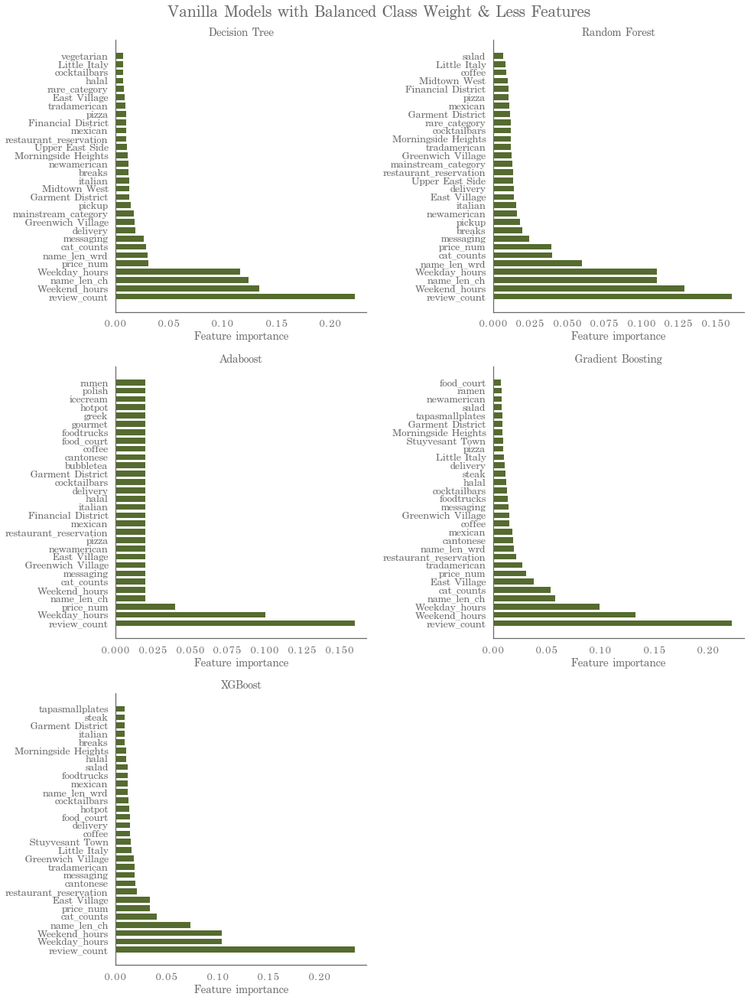

In [163]:
# feature importance
fig, ax = plt.subplots(3, 2, figsize=(14,18))
for index in range(len(pipelines_avg_feat)-1):
    plt.subplot(3,2,index+1)
    plot_feature_importances(X_avg_feat, pipelines_avg_feat[1+index].steps[0][1])
    plt.title('{}'.format(pipeline_avg_feat_names[1+index]), size=14)
    
fig.tight_layout()
fig.delaxes(ax[-1,-1])
plt.suptitle('Vanilla Models with Balanced Class Weight & Less Features', size=20, y=1.01, weight='bold')
plt.show()

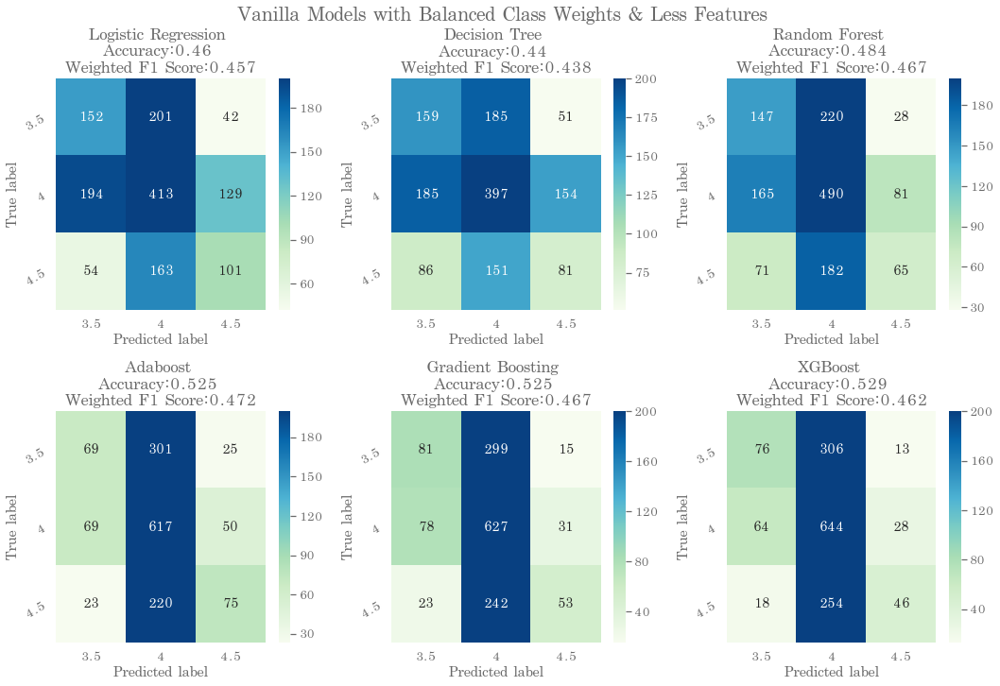

In [164]:
# confusion matrix
fig, ax = plt.subplots(2, 3, figsize=(15,10))

for index, val in enumerate(pipelines_avg_feat):
    plt.subplot(2,3,index+1)
    plot_cm(target = y_avg_feat_test, 
            labels = val.predict(X_avg_feat_test_transformed),
            name = pipeline_avg_feat_names[index],
            target_classes=3)
    
fig.tight_layout()
plt.suptitle('Vanilla Models with Balanced Class Weights & Less Features', size=20, y=1.01, weight='bold')
plt.show()

### Vanilla Models with Different Class Weights & Less Features, Excluding 5-Star Ratings

In [165]:
data_avg_excl5['rating_cat'].value_counts(normalize=True)

8.0    0.508387
7.0    0.290951
9.0    0.200663
Name: rating_cat, dtype: float64

#### Fitting the Model

In [166]:
class_weights = ['balanced', 
                 {7:0.3, 8:0.2, 9:0.5}, {7:0.2, 8:0.2, 9:0.6},
                 {7:0.2, 8:0.3, 9:0.5}, {7:0.1, 8:0.3, 9:0.6},
                 {7:0.1, 8:0.2, 9:0.7}]

# pipelines
pipelines_class = []
pipeline_class_names = []
for i in range(len(class_weights)):
    log_pipe = Pipeline([('clf', LogisticRegression(random_state=123, class_weight=class_weights[i]))])
    pipelines_class.append(log_pipe)
    pipeline_class_names.append('Logistic Regression{}'.format(i))

for i in range(len(class_weights)):
    tree_pipe = Pipeline([('clf', DecisionTreeClassifier(random_state=123, class_weight=class_weights[i]))])
    pipelines_class.append(tree_pipe)
    pipeline_class_names.append('Decision Tree{}'.format(i))
    
for i in range(len(class_weights)):
    forest_pipe = Pipeline([('clf', RandomForestClassifier(random_state=123, class_weight=class_weights[i]))])
    pipelines_class.append(forest_pipe)
    pipeline_class_names.append('Random Forest{}'.format(i))

# Loop to fit each of the three pipelines
for pipe in pipelines_class:
    print(pipe)
    pipe.fit(X_avg_feat_train_transformed, np.ravel(y_avg_feat_train))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight={7: 0.3, 8: 0.2, 9: 0.5}, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight={7: 0.2, 8: 0.2, 9: 0.6}, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     ste

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight={7: 0.1, 8: 0.2, 9: 0.7}, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=123,
          solver='warn', tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight={7: 0.3, 8: 0.2, 9: 0.5},
            criterion='gini', max_depth=None, max_features=None,
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_sa

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators='warn', n_jobs=None, oob_score=False,
            random_state=123, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight={7: 0.3, 8: 0.2, 9: 0.5},
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators='warn', n_jobs=None, oob_score=False,
            random_state=123, verbose=0, warm_start=False))])
Pipeline(memory=None,
     ste

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight={7: 0.1, 8: 0.3, 9: 0.6},
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators='warn', n_jobs=None, oob_score=False,
            random_state=123, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight={7: 0.1, 8: 0.2, 9: 0.7},
            criterion='gini', max_depth=None, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators='warn', n_jobs=None, oob_score=False,
            random_state=123, verbose=0, warm_start=False))])


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


#### Results

In [167]:
# Compare accuracies & f1 score
print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_class):
    print('%s : %.3f' % (pipeline_class_names[index], val.score(X_avg_feat_test_transformed, 
                                                                   y_avg_feat_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_class):
    print('%s : %.3f' % (pipeline_class_names[index],
                         f1_score(y_avg_feat_test, val.predict(X_avg_feat_test_transformed), 
                                  average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression0 : 0.460
Logistic Regression1 : 0.474
Logistic Regression2 : 0.475
Logistic Regression3 : 0.510
Logistic Regression4 : 0.496
Logistic Regression5 : 0.471
Decision Tree0 : 0.440
Decision Tree1 : 0.412
Decision Tree2 : 0.418
Decision Tree3 : 0.442
Decision Tree4 : 0.429
Decision Tree5 : 0.407
Random Forest0 : 0.484
Random Forest1 : 0.489
Random Forest2 : 0.469
Random Forest3 : 0.478
Random Forest4 : 0.472
Random Forest5 : 0.475

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression0 : 0.457
Logistic Regression1 : 0.460
Logistic Regression2 : 0.447
Logistic Regression3 : 0.422
Logistic Regression4 : 0.389
Logistic Regression5 : 0.408
Decision Tree0 : 0.438
Decision Tree1 : 0.416
Decision Tree2 : 0.418
Decision Tree3 : 0.441
Decision Tree4 : 0.426
Decision Tree5 : 0.405
Random Forest0 : 0.467
Random Forest1 : 0.466


In [168]:
for index, pipe in enumerate(pipelines_class):
    print('----------------------------------------')
    print(pipeline_class_names[index])
    print('----------------------------------------')
    print(classification_report(y_avg_feat_test, pipe.predict(X_avg_feat_test_transformed)))

----------------------------------------
Logistic Regression0
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.38      0.38      0.38       395
         8.0       0.53      0.56      0.55       736
         9.0       0.37      0.32      0.34       318

   micro avg       0.46      0.46      0.46      1449
   macro avg       0.43      0.42      0.42      1449
weighted avg       0.46      0.46      0.46      1449

----------------------------------------
Logistic Regression1
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.40      0.30      0.34       395
         8.0       0.52      0.65      0.58       736
         9.0       0.38      0.29      0.33       318

   micro avg       0.47      0.47      0.47      1449
   macro avg       0.43      0.41      0.42      1449
weighted avg       0.46      0.47      0.46      1449

--------------------------------

#### Feature Importance & Confusion Matrix

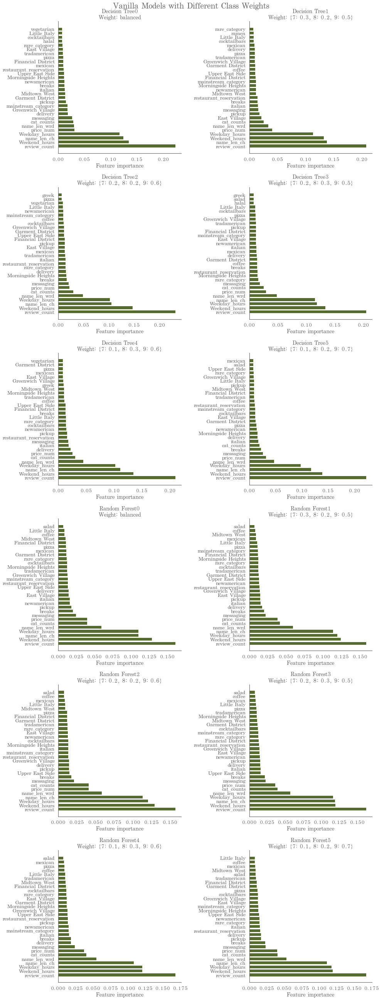

In [169]:
# feature importance 
fig, ax = plt.subplots(6, 2, figsize=(14,36))
for index in range(len(pipelines_class)-6):
    plt.subplot(6,2,index+1)
    plot_feature_importances(X_avg_feat, pipelines_class[6+index].steps[0][1])
    plt.title('{}\nWeight: {}'.format(pipeline_class_names[6+index], class_weights[index%6]),
             size=14, weight='bold')
    
fig.tight_layout()
plt.suptitle('Vanilla Models with Different Class Weights', size=20, y=1.0, weight='bold')
plt.show()

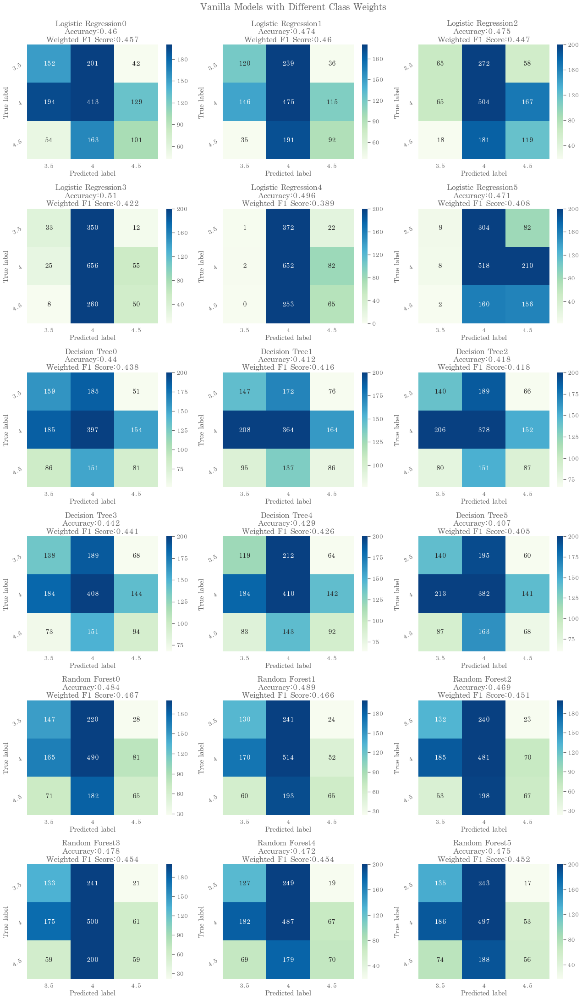

In [170]:
# confusion matrix
fig, ax = plt.subplots(6, 3, figsize=(18,30))
for index, val in enumerate(pipelines_class):
    plt.subplot(6,3,index+1)
    plot_cm(target = y_avg_feat_test, 
            labels = val.predict(X_avg_feat_test_transformed),
            name = pipeline_class_names[index],
            target_classes=3)
    
fig.tight_layout()
plt.suptitle('Vanilla Models with Different Class Weights', size=20, y=1.01, weight='bold')
plt.show()

### Vanilla Models with SMOTE Oversampling & Less Features, Excluding 5-Star Ratings

#### Fitting the Model

In [186]:
# Use the SMOTE class from the imblearn package in order to improve 
# the model's performance on the minority class.
# SMOTE should only be applied to training sets.

smote = SMOTE(random_state=1)
X_avg_feat_train_resampled, y_avg_feat_train_resampled = smote.fit_sample(X_avg_feat_train_transformed, 
                                                                          y_avg_feat_train) 

# Original class distribution
print('Original class distribution: \n')
print(y_avg_feat_train['rating_cat'].value_counts())

# Synthetic sample class distribution
print('-----------------------------------------')
print('Synthetic sample class distribution: \n')
print(pd.Series(y_avg_feat_train_resampled).value_counts())

Original class distribution: 

8.0    1719
7.0    1010
9.0     651
Name: rating_cat, dtype: int64
-----------------------------------------
Synthetic sample class distribution: 

9.0    1719
8.0    1719
7.0    1719
dtype: int64


/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/utils/validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [187]:
# running all feature
pipe_avg_feat_smote_log = Pipeline([('clf', LogisticRegression(random_state=123))])
pipe_avg_feat_smote_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123))])
pipe_avg_feat_smote_forest = Pipeline([('clf', RandomForestClassifier(random_state=123))])
pipe_avg_feat_smote_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_avg_feat_smote_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_avg_feat_smote_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_avg_feat_smote = [pipe_avg_feat_smote_log, pipe_avg_feat_smote_tree, pipe_avg_feat_smote_forest, 
                 pipe_avg_feat_smote_adaboost, pipe_avg_feat_smote_gbt, pipe_avg_feat_smote_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_avg_feat_smote:
    print(pipe)
    pipe.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=123, solver='warn',
          tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_sp

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=1.0, n_estimators=50, random_state=123))])
Pipeline(memory=None,
     steps=[('clf', GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_...    subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       see

#### Results

In [188]:
# Compare accuracies & f1 score
pipeline_avg_feat_smote_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg_feat_smote):
    print('%s : %.3f' % (pipeline_avg_feat_names[index], val.score(X_avg_feat_test_transformed, 
                                                                   y_avg_feat_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg_feat_smote):
    print('%s : %.3f' % (pipeline_avg_feat_smote_names[index],
                         f1_score(y_avg_feat_test, val.predict(X_avg_feat_test_transformed), 
                                  average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.406
Decision Tree : 0.420
Random Forest : 0.449
Adaboost : 0.445
Gradient Boosting : 0.500
XGBoost : 0.497

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.399
Decision Tree : 0.423
Random Forest : 0.448
Adaboost : 0.448
Gradient Boosting : 0.495
XGBoost : 0.493


In [189]:
for index, pipe in enumerate(pipelines_avg_feat_smote):
    print('----------------------------------------')
    print(pipeline_avg_feat_smote_names[index])
    print('----------------------------------------')
    print(classification_report(y_avg_feat_test, pipe.predict(X_avg_feat_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.39      0.57      0.46       395
         8.0       0.57      0.27      0.37       736
         9.0       0.31      0.51      0.39       318

   micro avg       0.41      0.41      0.41      1449
   macro avg       0.43      0.45      0.41      1449
weighted avg       0.47      0.41      0.40      1449

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.34      0.39      0.36       395
         8.0       0.53      0.48      0.50       736
         9.0       0.30      0.31      0.31       318

   micro avg       0.42      0.42      0.42      1449
   macro avg       0.39      0.40      0.39      1449
weighted avg       0.43      0.42      0.42      1449

----------------------------------------

#### Feature Importance & Confusion Matrix

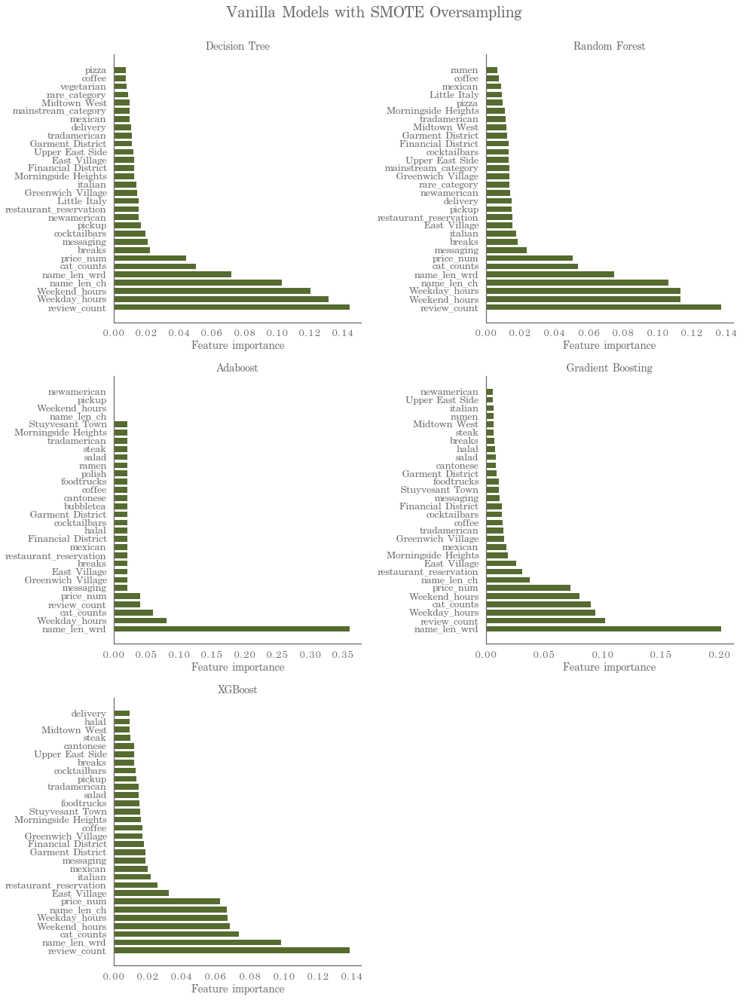

In [190]:
# feature importance
fig, ax = plt.subplots(3, 2, figsize=(14,18))
for index in range(len(pipelines_avg_feat_smote)-1):
    plt.subplot(3,2,index+1)
    plot_feature_importances(X_avg_feat, pipelines_avg_feat_smote[1+index].steps[0][1])
    plt.title('{}'.format(pipeline_avg_feat_smote_names[1+index]), size=14, weight='bold')
    
fig.tight_layout()
fig.delaxes(ax[-1,-1])
plt.suptitle('Vanilla Models with SMOTE Oversampling', size=20, y=1.025, weight='bold')
plt.show()

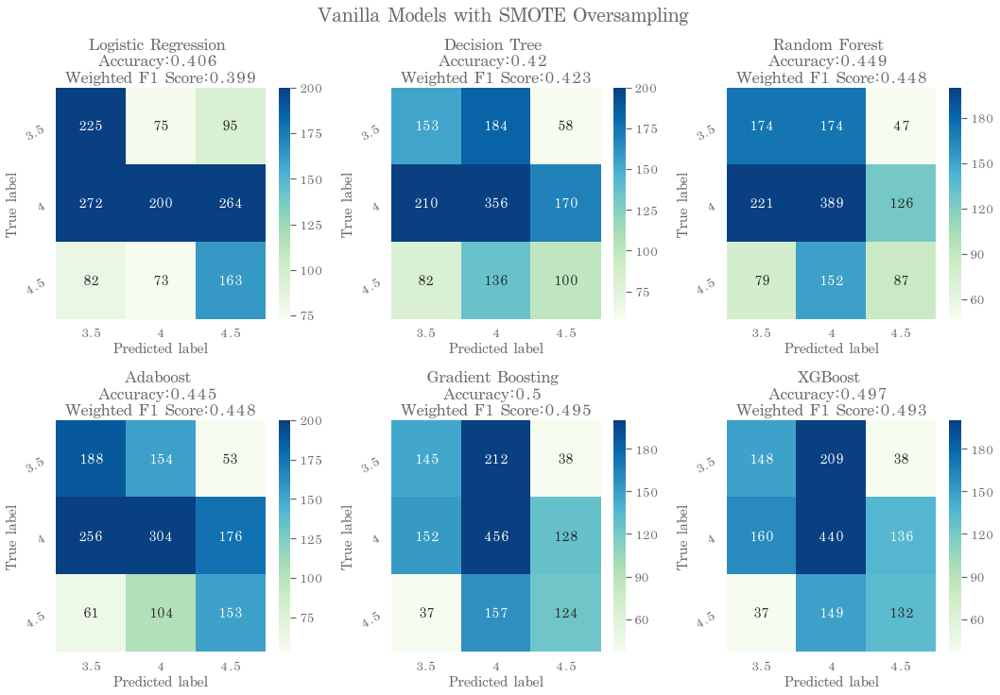

In [191]:
# confusion matrix
fig, ax = plt.subplots(2, 3, figsize=(15,10))

for index, val in enumerate(pipelines_avg_feat_smote):
    plt.subplot(2,3,index+1)
    plot_cm(target = y_avg_feat_test, 
            labels = val.predict(X_avg_feat_test_transformed),
            name = pipeline_avg_feat_smote_names[index],
            target_classes=3)
    
fig.tight_layout()
plt.suptitle('Vanilla Models with SMOTE Oversampling', size=20, y=1.025, weight='bold')
plt.show()

### Vanilla Models with Undersampling, Less Features & Excluding 5-Star Ratings

#### Fitting the Model

In [192]:
# Use RandomUnderSampler from the imblearn package in order to improve 
# the model's performance on the minority class.
# RandomUnderSampler should only be applied to training sets.

under = RandomUnderSampler(random_state=123)
X_avg_feat_train_undersampled, y_avg_feat_train_undersampled = under.fit_resample(X_avg_feat_train_transformed, 
                                                                          y_avg_feat_train) 

# Original class distribution
print('Original class distribution: \n')
print(y_avg_feat_train['rating_cat'].value_counts())

# Synthetic sample class distribution
print('-----------------------------------------')
print('Synthetic sample class distribution: \n')
print(pd.Series(np.ravel(y_avg_feat_train_undersampled)).value_counts())

Original class distribution: 

8.0    1719
7.0    1010
9.0     651
Name: rating_cat, dtype: int64
-----------------------------------------
Synthetic sample class distribution: 

9.0    651
8.0    651
7.0    651
dtype: int64


In [193]:
# running all feature
pipe_avg_feat_under_log = Pipeline([('clf', LogisticRegression(random_state=123))])
pipe_avg_feat_under_tree = Pipeline([('clf', DecisionTreeClassifier(random_state=123))])
pipe_avg_feat_under_forest = Pipeline([('clf', RandomForestClassifier(random_state=123))])
pipe_avg_feat_under_adaboost = Pipeline([('clf', AdaBoostClassifier(random_state=123))])
pipe_avg_feat_under_gbt = Pipeline([('clf', GradientBoostingClassifier(random_state=123))])
pipe_avg_feat_under_xgb = Pipeline([('clf', XGB.XGBClassifier(random_state=123))])

# List of pipelines, List of pipeline names
pipelines_avg_feat_under = [pipe_avg_feat_under_log, pipe_avg_feat_under_tree, pipe_avg_feat_under_forest, 
                 pipe_avg_feat_under_adaboost, pipe_avg_feat_under_gbt, pipe_avg_feat_under_xgb]

# Loop to fit each of the three pipelines
for pipe in pipelines_avg_feat_under:
    print(pipe)
    pipe.fit(X_avg_feat_train_undersampled, np.ravel(y_avg_feat_train_undersampled))

Pipeline(memory=None,
     steps=[('clf', LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=123, solver='warn',
          tol=0.0001, verbose=0, warm_start=False))])
Pipeline(memory=None,
     steps=[('clf', DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=123,
            splitter='best'))])
Pipeline(memory=None,
     steps=[('clf', RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_sp

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Pipeline(memory=None,
     steps=[('clf', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic',
       random_state=123, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=True, subsample=1))])


#### Results

In [194]:
# Compare accuracies & f1 score
pipeline_avg_feat_under_names = ['Logistic Regression', 'Decision Tree','Random Forest', 
                      'Adaboost', 'Gradient Boosting', 'XGBoost']

print('----------------------------------------')
print('Accuracy')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg_feat_under):
    print('%s : %.3f' % (pipeline_avg_feat_under_names[index], val.score(X_avg_feat_test_transformed, 
                                                                   y_avg_feat_test)))
    
print('\n----------------------------------------')    
print('Weighted F1 Score')
print('----------------------------------------')
for index, val in enumerate(pipelines_avg_feat_under):
    print('%s : %.3f' % (pipeline_avg_feat_under_names[index],
                         f1_score(y_avg_feat_test, val.predict(X_avg_feat_test_transformed), 
                                  average='weighted')))

----------------------------------------
Accuracy
----------------------------------------
Logistic Regression : 0.401
Decision Tree : 0.377
Random Forest : 0.431
Adaboost : 0.415
Gradient Boosting : 0.429
XGBoost : 0.433

----------------------------------------
Weighted F1 Score
----------------------------------------
Logistic Regression : 0.393
Decision Tree : 0.385
Random Forest : 0.434
Adaboost : 0.405
Gradient Boosting : 0.426
XGBoost : 0.428


In [195]:
for index, pipe in enumerate(pipelines_avg_feat_under):
    print('----------------------------------------')
    print(pipeline_avg_feat_under_names[index])
    print('----------------------------------------')
    print(classification_report(y_avg_feat_test, pipe.predict(X_avg_feat_test_transformed)))

----------------------------------------
Logistic Regression
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.38      0.55      0.45       395
         8.0       0.56      0.26      0.36       736
         9.0       0.32      0.53      0.40       318

   micro avg       0.40      0.40      0.40      1449
   macro avg       0.42      0.45      0.40      1449
weighted avg       0.46      0.40      0.39      1449

----------------------------------------
Decision Tree
----------------------------------------
              precision    recall  f1-score   support

         7.0       0.32      0.38      0.35       395
         8.0       0.53      0.37      0.43       736
         9.0       0.27      0.39      0.32       318

   micro avg       0.38      0.38      0.38      1449
   macro avg       0.37      0.38      0.37      1449
weighted avg       0.41      0.38      0.38      1449

----------------------------------------

#### Feature Importance & Confusion Matrix

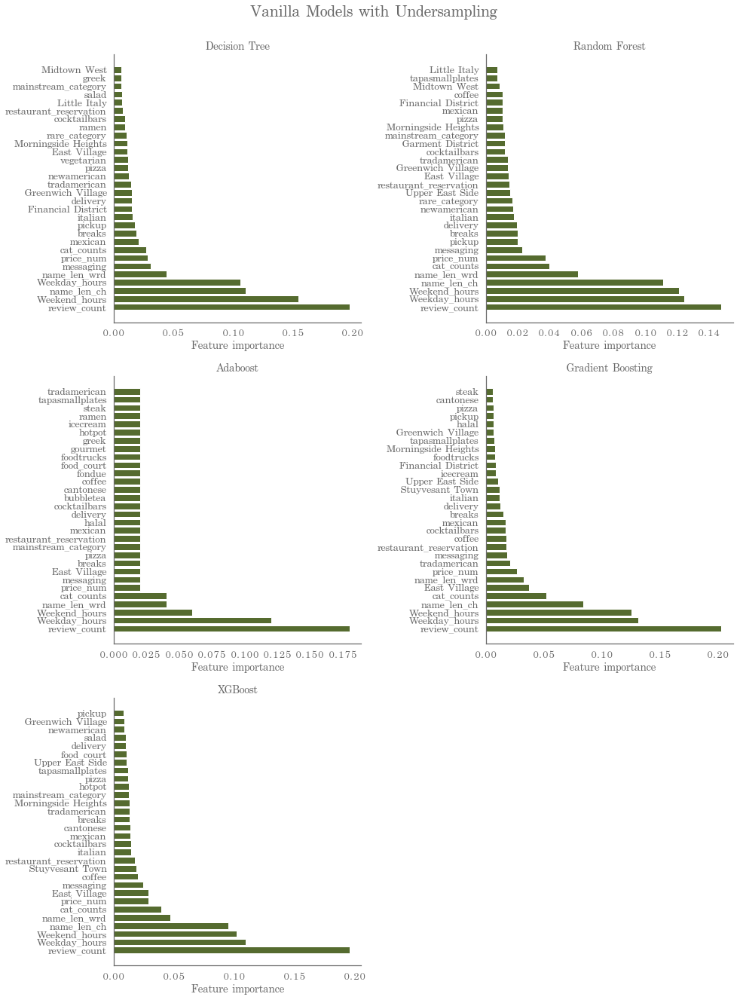

In [196]:
# feature importance
fig, ax = plt.subplots(3, 2, figsize=(14,18))
for index in range(len(pipelines_avg_feat_under)-1):
    plt.subplot(3,2,index+1)
    plot_feature_importances(X_avg_feat, pipelines_avg_feat_under[1+index].steps[0][1])
    plt.title('{}'.format(pipeline_avg_feat_under_names[1+index]), size=14, weight='bold')
    
fig.tight_layout()
fig.delaxes(ax[-1,-1])
plt.suptitle('Vanilla Models with Undersampling', size=20, y=1.025, weight='bold')
plt.show()

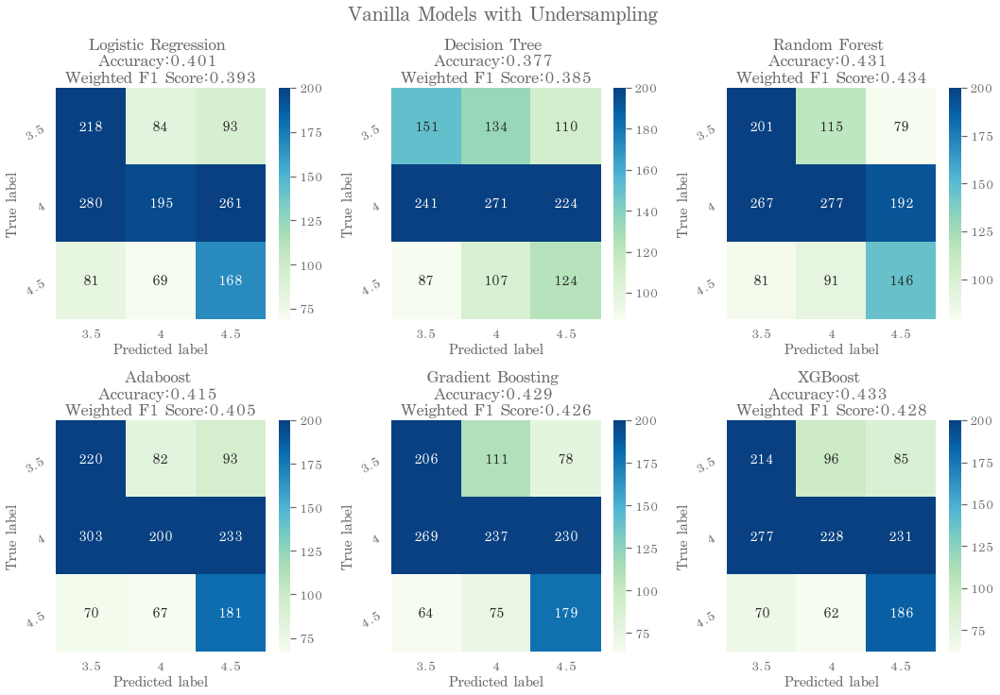

In [197]:
# confusion matrix
fig, ax = plt.subplots(2, 3, figsize=(15,10))

for index, val in enumerate(pipelines_avg_feat_under):
    plt.subplot(2,3,index+1)
    plot_cm(target = y_avg_feat_test, 
            labels = val.predict(X_avg_feat_test_transformed),
            name = pipeline_avg_feat_under_names[index],
            target_classes=3)
    
fig.tight_layout()
plt.suptitle('Vanilla Models with Undersampling', size=20, y=1.025, weight='bold')
plt.show()

## Refining Models Using GridSearchCV

I will focus on predicting ratings of 3.5, 4 and 4.5 -- of which most of restaurants fall in. The performances (weighted F1 scores) of the vanilla models were generally higher with SMOTE Oversampling. Therefore, I will refine 2 models with SMOTE oversampled datasets using GridSearchCV.    

### Refining Models with SMOTE Oversampling, Less Features & Excluding 5-Star Ratings

#### Adaboost (Highest F1 Score for 4.5 Ratings)

##### Hyper Parameter Tuning

In [198]:
adaboost_param = {
    'clf__random_state' : [123],
}

gs_adaboost = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))
gs_adaboost.best_params_, gs_adaboost.best_score_

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.3s finished


({'clf__random_state': 123}, 0.5129574493564707)

In [199]:
# 1. Fix best estimator
adaboost_param1 = {
    'clf__base_estimator': [None, 
                            DecisionTreeClassifier(random_state=123),
                            DecisionTreeClassifier(class_weight={7:0.2, 8:0.3, 9:0.5}, random_state=123),
                            DecisionTreeClassifier(class_weight={7:0.1, 8:0.3, 9:0.6}, random_state=123),
                            RandomForestClassifier(random_state=123),
                            RandomForestClassifier(class_weight={7:0.2, 8:0.3, 9:0.5}, random_state=123),
                            RandomForestClassifier(class_weight={7:0.1, 8:0.3, 9:0.6}, random_state=123)],
    'clf__random_state' : [123],
}

gs_adaboost1 = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param1,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost1.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_adaboost_gs1_v2.sav'
pickle.dump(gs_adaboost1, open(filename, 'wb'))
# gs_adaboost1 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 7 candidates, totalling 35 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  35 out of  35 | elapsed:   55.6s finished
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change 

/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/yelp/lib/python3.6/site-packages/skl

In [200]:
gs_adaboost1.best_params_, gs_adaboost1.best_score_

({'clf__base_estimator': RandomForestClassifier(bootstrap=True, class_weight={7: 0.1, 8: 0.3, 9: 0.6},
              criterion='gini', max_depth=None, max_features='auto',
              max_leaf_nodes=None, min_impurity_decrease=0.0,
              min_impurity_split=None, min_samples_leaf=1,
              min_samples_split=2, min_weight_fraction_leaf=0.0,
              n_estimators='warn', n_jobs=None, oob_score=False,
              random_state=123, verbose=0, warm_start=False),
  'clf__random_state': 123},
 0.6910607134318721)

In [201]:
adaboost_models = [gs_adaboost, gs_adaboost1]

for i in range(len(adaboost_models)):
    print('-----------------------')
    print('Grid Search #{}'.format(i))
    print('-----------------------')
    print(classification_report(y_avg_feat_test,
                                adaboost_models[i].predict(X_avg_feat_test_transformed)))

-----------------------
Grid Search #0
-----------------------
              precision    recall  f1-score   support

         7.0       0.37      0.48      0.42       395
         8.0       0.54      0.41      0.47       736
         9.0       0.40      0.48      0.44       318

   micro avg       0.45      0.45      0.45      1449
   macro avg       0.44      0.46      0.44      1449
weighted avg       0.46      0.45      0.45      1449

-----------------------
Grid Search #1
-----------------------
              precision    recall  f1-score   support

         7.0       0.34      0.33      0.34       395
         8.0       0.53      0.59      0.56       736
         9.0       0.42      0.31      0.35       318

   micro avg       0.46      0.46      0.46      1449
   macro avg       0.43      0.41      0.42      1449
weighted avg       0.45      0.46      0.45      1449



The f-1 score for the 4.5 rating restaurants decreased when run with decision tree or random forest classifiers as base estimators with class weights determined from previous section (vanilla models with different class weights; identified class weights that had higher F-1 scores for the minority classes). In order to focus on the predictability of 4.5 rating restaurants, I would continue with the default base estimator, even though using Random Forest Classifier as the base estimator resulted in higher weighted F-1 score.

In [202]:
# 2. Fix learning rate and number of estimators for tuning tree-based parameters
adaboost_param2 = {
    'clf__learning_rate': [0.05, 0.1, 0.2, 0.3],
    'clf__n_estimators': [30, 70, 50, 100, 500],
    'clf__random_state' : [123],
}

gs_adaboost2 = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param2,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost2.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_adaboost_gs2_v2.sav'
pickle.dump(gs_adaboost2, open(filename, 'wb'))
# gs_adaboost2 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.1min finished


In [203]:
gs_adaboost2.best_params_, gs_adaboost2.best_score_

({'clf__learning_rate': 0.3,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.543655003325089)

In [204]:
# 3. Further tune learning rate and number of estimators
adaboost_param3 = {
    'clf__learning_rate': [0.25, 0.3, 0.35, 4],
    'clf__n_estimators': [200, 350, 500, 700, 900],
    'clf__random_state' : [123],
}

gs_adaboost3 = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param3,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost3.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_adaboost_gs3_v2.sav'
pickle.dump(gs_adaboost3, open(filename, 'wb'))
# gs_adaboost3 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   44.3s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.8min finished


In [205]:
gs_adaboost3.best_params_, gs_adaboost3.best_score_

({'clf__learning_rate': 0.3,
  'clf__n_estimators': 900,
  'clf__random_state': 123},
 0.5550264228211178)

In [206]:
# 4. Further tune number of estimators
adaboost_param4 = {
    'clf__learning_rate': [0.3],
    'clf__n_estimators': [750, 800, 850, 900, 950, 1000, 2000],
    'clf__random_state' : [123],
}

gs_adaboost4 = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param4,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost4.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_adaboost_gs4_v2.sav'
pickle.dump(gs_adaboost4, open(filename, 'wb'))
# gs_adaboost4 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 7 candidates, totalling 35 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  35 out of  35 | elapsed:  2.1min finished


In [207]:
gs_adaboost4.best_params_, gs_adaboost4.best_score_

({'clf__learning_rate': 0.3,
  'clf__n_estimators': 900,
  'clf__random_state': 123},
 0.5550264228211178)

In [208]:
# 5. Determine algorithm
adaboost_param5 = {
    'clf__learning_rate': [0.3],
    'clf__n_estimators': [900],
    'clf__algorithm': ['SAMME', 'SAMME.R'],
    'clf__random_state' : [123],
}

gs_adaboost5 = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param5,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost5.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_adaboost_gs5_v2.sav'
pickle.dump(gs_adaboost5, open(filename, 'wb'))
# gs_adaboost5 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 2 candidates, totalling 10 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   29.1s finished


In [209]:
gs_adaboost5.best_params_, gs_adaboost5.best_score_

({'clf__algorithm': 'SAMME.R',
  'clf__learning_rate': 0.3,
  'clf__n_estimators': 900,
  'clf__random_state': 123},
 0.5550264228211178)

In [210]:
# 6. Decrease learning rate and increase n_estimators proportionally
adaboost_param6 = {
    'clf__learning_rate': [0.15],
    'clf__n_estimators': [1800],
    'clf__algorithm': ['SAMME.R'],
    'clf__random_state' : [123],
}

gs_adaboost6 = GridSearchCV(estimator = pipe_avg_feat_smote_adaboost,
                      param_grid = adaboost_param6,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_adaboost6.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_adaboost_gs6_v2.sav'
pickle.dump(gs_adaboost6, open(filename, 'wb'))
# gs_adaboost6 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   44.5s finished


In [211]:
gs_adaboost6.best_params_, gs_adaboost6.best_score_

({'clf__algorithm': 'SAMME.R',
  'clf__learning_rate': 0.15,
  'clf__n_estimators': 1800,
  'clf__random_state': 123},
 0.5522590870381788)

In [212]:
adaboost_models = [gs_adaboost, gs_adaboost1, gs_adaboost2, gs_adaboost3, gs_adaboost4, 
                   gs_adaboost5, gs_adaboost6]

for i in range(len(adaboost_models)):
    print('-----------------------')
    print('Grid Search #{}'.format(i))
    print('-----------------------')
    print(classification_report(y_avg_feat_test,
                                adaboost_models[i].predict(X_avg_feat_test_transformed)))

-----------------------
Grid Search #0
-----------------------
              precision    recall  f1-score   support

         7.0       0.37      0.48      0.42       395
         8.0       0.54      0.41      0.47       736
         9.0       0.40      0.48      0.44       318

   micro avg       0.45      0.45      0.45      1449
   macro avg       0.44      0.46      0.44      1449
weighted avg       0.46      0.45      0.45      1449

-----------------------
Grid Search #1
-----------------------
              precision    recall  f1-score   support

         7.0       0.34      0.33      0.34       395
         8.0       0.53      0.59      0.56       736
         9.0       0.42      0.31      0.35       318

   micro avg       0.46      0.46      0.46      1449
   macro avg       0.43      0.41      0.42      1449
weighted avg       0.45      0.46      0.45      1449

-----------------------
Grid Search #2
-----------------------
              precision    recall  f1-score   sup

##### Results

In [213]:
gs_adaboost6.best_params_, gs_adaboost6.best_score_

({'clf__algorithm': 'SAMME.R',
  'clf__learning_rate': 0.15,
  'clf__n_estimators': 1800,
  'clf__random_state': 123},
 0.5522590870381788)

In [215]:
# Final Adaboost Model with optimal hyperparameters
adaboost_final = AdaBoostClassifier(algorithm='SAMME.R',
                                   learning_rate=0.15,
                                   n_estimators=1800,
                                   random_state=123)

adaboost_final.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))                                

AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=0.15, n_estimators=1800, random_state=123)

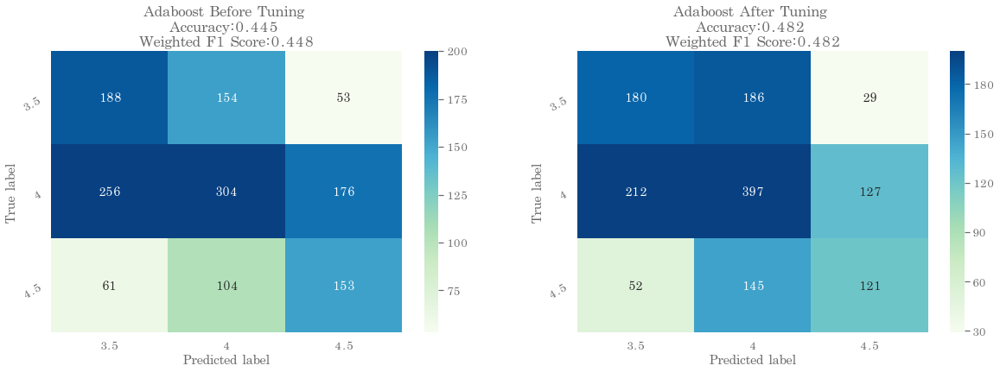

In [216]:
adaboost_final_pred = gs_adaboost6.predict(X_avg_feat_test_transformed)

fig, ax = plt.subplots(1,2, figsize=(20,6))
plt.subplot(1,2,1)
plot_cm(y_avg_feat_test, gs_adaboost.predict(X_avg_feat_test_transformed), name='Adaboost Before Tuning')

plt.subplot(1,2,2)
plot_cm(y_avg_feat_test, adaboost_final_pred, name='Adaboost After Tuning')

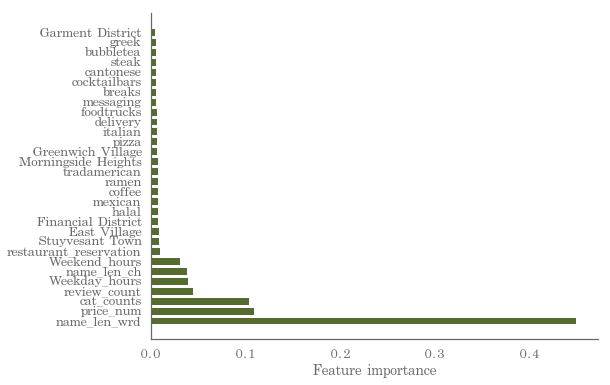

In [217]:
plt.figure(figsize=(8,6))
plot_feature_importances(X_avg_feat, adaboost_final)

#### Gradient Boosting (Highest Weighted F1 Score)

##### Hyper Parameter Tuning

In [218]:
gbt_param = {
    'clf__random_state' : [123],
}

gs_gbt = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs_v2.sav'
pickle.dump(gs_gbt, open(filename, 'wb'))
# gs_gbt = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    7.2s finished


In [219]:
gs_gbt.best_params_, gs_gbt.best_score_

({'clf__random_state': 123}, 0.5704218902582272)

In [220]:
# 1. Fix learning rate and number of estimators for tuning tree-based parameters
gbt_param1 = {
    'clf__learning_rate': [0.05, 0.1, 0.2, 0.3],
    'clf__n_estimators': [30, 70, 50, 100, 500],
    'clf__random_state' : [123],
}

gs_gbt1 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param1,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt1.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs1_v2.sav'
pickle.dump(gs_gbt1, open(filename, 'wb'))
# gs_gbt1 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   40.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.9min finished


In [221]:
gs_gbt1.best_params_, gs_gbt1.best_score_

({'clf__learning_rate': 0.2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.5958166983144842)

In [222]:
# 2. Further tune learning rate and number of estimators 
gbt_param2 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [400, 450, 500, 550],
    'clf__random_state' : [123],
}

gs_gbt2 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param2,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt2.fit(X_avg_feat_train_resampled, 
            np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs2_v2.sav'
pickle.dump(gs_gbt2, open(filename, 'wb'))
# gs_gbt2 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  1.8min finished


In [223]:
gs_gbt2.best_params_, gs_gbt2.best_score_

({'clf__learning_rate': 0.2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.5958166983144842)

In [226]:
# 3. Tune max_depth and min_samples_split
gbt_param3 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2,200,400,600,800,1000,
                               1200,1400,1600,1800,2000],
    'clf__max_depth': [3,5,7,9,11,13,15],
    'clf__random_state' : [123],
}

# gs_gbt3 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
#                       param_grid = gbt_param3,
#                       scoring='f1_weighted',
#                       cv=5, verbose=2, n_jobs=-1,
#                       return_train_score = True)

# gs_gbt3.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# # save model
# filename = 'smote_gbt_gs3_v2.sav'
# pickle.dump(gs_gbt3, open(filename, 'wb'))
gs_gbt3 = pickle.load(open(filename, 'rb'))

In [227]:
gs_gbt3.best_params_, gs_gbt3.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6476325255355674)

In [228]:
# 4. Further tune min_samples_split
gbt_param4 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2, 50, 100, 150],
    'clf__max_depth': [13],
    'clf__random_state' : [123],
}

gs_gbt4 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param4,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt4.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs4_v2.sav'
pickle.dump(gs_gbt4, open(filename, 'wb'))
# gs_gbt4 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  6.1min finished


In [229]:
gs_gbt4.best_params_, gs_gbt4.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6476325255355674)

In [230]:
# 5. Further tune min_samples_split
gbt_param5 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2, 5, 10, 20, 40],
    'clf__max_depth': [13],
    'clf__random_state' : [123],
}

gs_gbt5 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param5,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt5.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs5_v2.sav'
pickle.dump(gs_gbt5, open(filename, 'wb'))
# gs_gbt5 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  6.3min finished


In [231]:
gs_gbt5.best_params_, gs_gbt5.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6476325255355674)

In [232]:
# 6. Tune min_samples_leaf
gbt_param6 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1,10,20,30,40,50,60,70],
    'clf__max_depth': [13],
    'clf__random_state' : [123],
}

gs_gbt6 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param6,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt6.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs6_v2.sav'
pickle.dump(gs_gbt6, open(filename, 'wb'))
# gs_gbt6 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 10.1min
[Parallel(n_jobs=-1)]: Done  40 out of  40 | elapsed: 11.4min finished


In [233]:
gs_gbt6.best_params_, gs_gbt6.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6476325255355674)

In [234]:
# 7. Further tune min_samples_leaf
gbt_param7 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1,2,3,4,5,6,7,8,9,10],
    'clf__max_depth': [13],
    'clf__random_state' : [123],
}

gs_gbt7 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param7,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt7.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs7_v2.sav'
pickle.dump(gs_gbt7, open(filename, 'wb'))
# gs_gbt7 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  7.0min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:  9.9min finished


In [235]:
gs_gbt7.best_params_, gs_gbt7.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6476325255355674)

In [236]:
# 8. Tune max_features
gbt_param8 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1],
    'clf__max_depth': [13],
    'clf__max_features' : [None, 7, 9, 11, 13, 15, 17, 19],
    'clf__random_state' : [123],
}

gs_gbt8 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param8,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt8.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs8_v2.sav'
pickle.dump(gs_gbt8, open(filename, 'wb'))
# gs_gbt8 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  4.5min
[Parallel(n_jobs=-1)]: Done  40 out of  40 | elapsed:  5.4min finished


In [237]:
gs_gbt8.best_params_, gs_gbt8.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__max_features': 7,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6778921545740093)

In [238]:
# 9. Further tune max_features
gbt_param9 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1],
    'clf__max_depth': [13],
    'clf__max_features' : [None,1,2,3,4,5,6,7,8],
    'clf__random_state' : [123],
}

gs_gbt9 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param9,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt9.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs9_v2.sav'
pickle.dump(gs_gbt9, open(filename, 'wb'))
# gs_gbt9 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed:  6.1min finished


In [239]:
gs_gbt9.best_params_, gs_gbt9.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__max_features': 1,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123},
 0.6883640016285566)

In [240]:
# 10. Tune subsample
gbt_param10 = {
    'clf__learning_rate': [0.2],
    'clf__n_estimators': [500],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1],
    'clf__max_depth': [13],
    'clf__max_features' : [1],
    'clf__subsample': [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9],
    'clf__random_state' : [123],
}

gs_gbt10 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param10,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt10.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs10_v2.sav'
pickle.dump(gs_gbt10, open(filename, 'wb'))
# gs_gbt10 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 7 candidates, totalling 35 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  35 out of  35 | elapsed:  4.8min finished


In [241]:
gs_gbt10.best_params_, gs_gbt10.best_score_

({'clf__learning_rate': 0.2,
  'clf__max_depth': 13,
  'clf__max_features': 1,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 500,
  'clf__random_state': 123,
  'clf__subsample': 0.7},
 0.692545119108967)

In [242]:
# 11. Lower the learning rate and increase the estimators # 
# proportionally
gbt_param11 = {
    'clf__learning_rate': [0.1],
    'clf__n_estimators': [1000],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1],
    'clf__max_depth': [13],
    'clf__max_features' : [1],
    'clf__subsample': [0.7],
    'clf__random_state' : [123],
}

gs_gbt11 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param11,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt11.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs11_v2.sav'
pickle.dump(gs_gbt11, open(filename, 'wb'))
# gs_gbt11 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.5min finished


In [243]:
gs_gbt11.best_params_, gs_gbt11.best_score_

({'clf__learning_rate': 0.1,
  'clf__max_depth': 13,
  'clf__max_features': 1,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 1000,
  'clf__random_state': 123,
  'clf__subsample': 0.7},
 0.6914110879981998)

In [244]:
# 12. Lower the learning rate and increase the estimators # 
# proportionally
gbt_param12 = {
    'clf__learning_rate': [0.05],
    'clf__n_estimators': [2000],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1],
    'clf__max_depth': [13],
    'clf__max_features' : [1],
    'clf__subsample': [0.7],
    'clf__random_state' : [123],
}

gs_gbt12 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param12,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt12.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs12_v2.sav'
pickle.dump(gs_gbt12, open(filename, 'wb'))
# gs_gbt12 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.3min finished


In [245]:
gs_gbt12.best_params_, gs_gbt12.best_score_

({'clf__learning_rate': 0.05,
  'clf__max_depth': 13,
  'clf__max_features': 1,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 2000,
  'clf__random_state': 123,
  'clf__subsample': 0.7},
 0.6976539497848315)

In [252]:
# 13. Lower the learning rate and increase the estimators # 
# proportionally
gbt_param13 = {
    'clf__learning_rate': [0.025],
    'clf__n_estimators': [4000],
    'clf__min_samples_split': [2],
    'clf__min_samples_leaf' : [1],
    'clf__max_depth': [13],
    'clf__max_features' : [1],
    'clf__subsample': [0.7],
    'clf__random_state' : [123],
}

gs_gbt13 = GridSearchCV(estimator = pipe_avg_feat_smote_gbt,
                      param_grid = gbt_param13,
                      scoring='f1_weighted',
                      cv=5, verbose=2, n_jobs=-1,
                      return_train_score = True)

gs_gbt13.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))

# save model
filename = 'smote_gbt_gs13_v2.sav'
pickle.dump(gs_gbt13, open(filename, 'wb'))
# gs_gbt13 = pickle.load(open(filename, 'rb'))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  5.8min finished


In [253]:
gs_gbt13.best_params_, gs_gbt13.best_score_

({'clf__learning_rate': 0.025,
  'clf__max_depth': 13,
  'clf__max_features': 1,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 4000,
  'clf__random_state': 123,
  'clf__subsample': 0.7},
 0.6932852168842455)

In [254]:
gbt_models = [gs_gbt, gs_gbt1, gs_gbt2, gs_gbt3, gs_gbt4, gs_gbt5, 
          gs_gbt6, gs_gbt7, gs_gbt8, gs_gbt9, gs_gbt10,
          gs_gbt11, gs_gbt12, gs_gbt13]

for i in range(len(gbt_models)):
    print('-----------------------')
    print('Grid Search #{}'.format(i))
    print('-----------------------')
    print(classification_report(y_avg_feat_test,
                                gbt_models[i].predict(X_avg_feat_test_transformed)))

-----------------------
Grid Search #0
-----------------------
              precision    recall  f1-score   support

         7.0       0.43      0.37      0.40       395
         8.0       0.55      0.62      0.58       736
         9.0       0.43      0.39      0.41       318

   micro avg       0.50      0.50      0.50      1449
   macro avg       0.47      0.46      0.46      1449
weighted avg       0.49      0.50      0.49      1449

-----------------------
Grid Search #1
-----------------------
              precision    recall  f1-score   support

         7.0       0.41      0.37      0.39       395
         8.0       0.55      0.63      0.59       736
         9.0       0.44      0.35      0.39       318

   micro avg       0.50      0.50      0.50      1449
   macro avg       0.47      0.45      0.46      1449
weighted avg       0.49      0.50      0.49      1449

-----------------------
Grid Search #2
-----------------------
              precision    recall  f1-score   sup

##### Results

In [255]:
gs_gbt13.best_params_, gs_gbt13.best_score_

({'clf__learning_rate': 0.025,
  'clf__max_depth': 13,
  'clf__max_features': 1,
  'clf__min_samples_leaf': 1,
  'clf__min_samples_split': 2,
  'clf__n_estimators': 4000,
  'clf__random_state': 123,
  'clf__subsample': 0.7},
 0.6932852168842455)

In [256]:
print(classification_report(y_avg_feat_test, gs_gbt.predict(X_avg_feat_test_transformed)))
print(classification_report(y_avg_feat_test, gs_gbt13.predict(X_avg_feat_test_transformed)))

              precision    recall  f1-score   support

         7.0       0.43      0.37      0.40       395
         8.0       0.55      0.62      0.58       736
         9.0       0.43      0.39      0.41       318

   micro avg       0.50      0.50      0.50      1449
   macro avg       0.47      0.46      0.46      1449
weighted avg       0.49      0.50      0.49      1449

              precision    recall  f1-score   support

         7.0       0.39      0.35      0.37       395
         8.0       0.55      0.64      0.59       736
         9.0       0.38      0.28      0.33       318

   micro avg       0.48      0.48      0.48      1449
   macro avg       0.44      0.42      0.43      1449
weighted avg       0.47      0.48      0.47      1449



In [257]:
# Final Gradient Boosting Model after hyperparameters tuning
gbt_final = GradientBoostingClassifier(learning_rate = 0.025,
                                       n_estimators = 4000,
                                       max_depth = 13,
                                       max_features = 1,
                                       min_samples_leaf = 1,
                                       min_samples_split = 2,
                                       subsample = 0.7,
                                       random_state=123)

gbt_final.fit(X_avg_feat_train_resampled, np.ravel(y_avg_feat_train_resampled))                                

GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.025, loss='deviance', max_depth=13,
              max_features=1, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_samples_split=2,
              min_weight_fraction_leaf=0.0, n_estimators=4000,
              n_iter_no_change=None, presort='auto', random_state=123,
              subsample=0.7, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False)

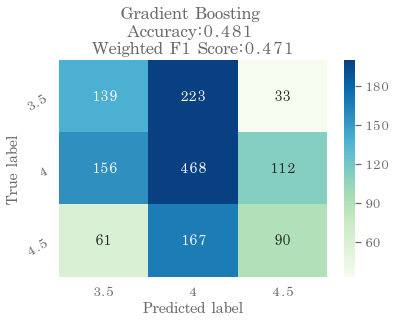

In [258]:
gbt_final_pred = gs_gbt13.predict(X_avg_feat_test_transformed)
plot_cm(y_avg_feat_test, gbt_final_pred, name='Gradient Boosting')

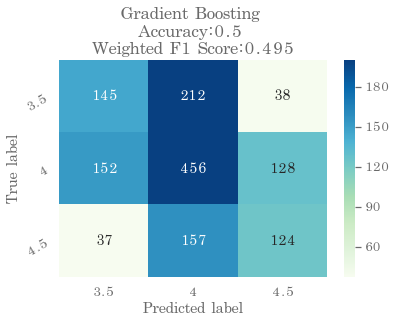

In [259]:
gbt_vanilla_pred = gs_gbt.predict(X_avg_feat_test_transformed)
plot_cm(y_avg_feat_test, gbt_vanilla_pred, name='Gradient Boosting')

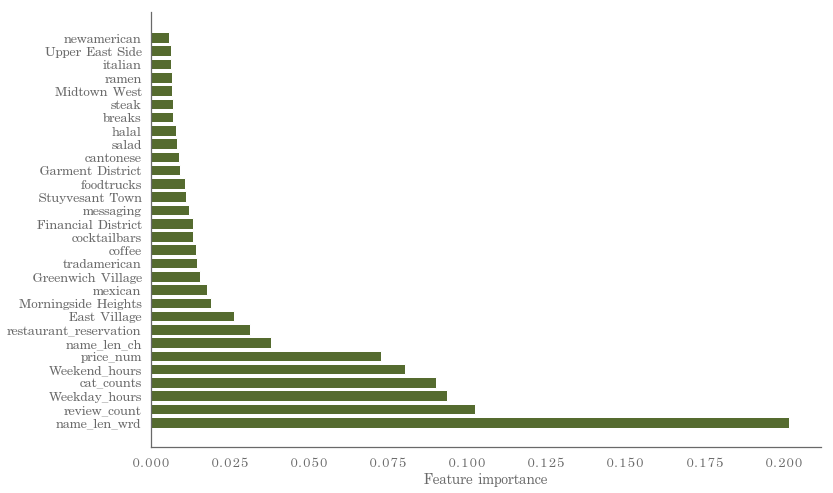

In [260]:
plt.figure(figsize=(12,8))
plot_feature_importances(X_avg_feat, pipe_avg_feat_smote_gbt.steps[0][1])
# same as:
# plt.figure(figsize=(12,8))
# plot_feature_importances(X_avg_feat, gs_gbt.estimator.steps[0][1])

### Understanding Models using LIME package

In [270]:
pipe_avg_feat_smote_adaboost.steps[0][1]

AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None,
          learning_rate=1.0, n_estimators=50, random_state=123)

In [271]:
# 1. Create a lambda function for each classifier that will return 
# the predicted probability for the target variable given the set of features
predict_vn_adaboost = lambda x: pipe_avg_feat_smote_adaboost.steps[0][1].predict_proba(x).astype(float)
predict_fn_adaboost = lambda x: adaboost_final.predict_proba(x).astype(float)

predict_vn_gbt = lambda x: pipe_avg_feat_smote_gbt.steps[0][1].predict_proba(x).astype(float)
predict_fn_gbt = lambda x: gbt_final.predict_proba(x).astype(float)

# 2. Create a concatenated list of all feature names which will be 
# utilized by the LIME explainer in subsequent steps
feature_names = list(X_avg_feat.columns)
feature_names_cat = ['messaging', 'Greenwich Village', 'East Village', 'pickup','newamerican',
                     'Midtown West', 'pizza', 'mainstream_category','restaurant_reservation', 'mexican', 
                     'Financial District', 'italian', 'halal', 'delivery', 'cocktailbars', 
                     'rare_category', 'Garment District', 'Upper East Side', 'bubbletea', 'cantonese',
                     'coffee', 'fondue', 'food_court', 'foodtrucks', 'gourmet', 
                     'greek', 'hotpot', 'icecream', 'polish', 'ramen', 
                     'salad', 'steak', 'tapasmallplates', 'tradamerican', 'vegetarian', 
                     'Little Italy','Morningside Heights', 'Stuyvesant Town']

# 3. Create the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(X_avg_feat_train_resampled, 
                                                   feature_names = feature_names,
                                                   class_names = [3.5, 4, 4.5],
                                                   categorical_features = feature_names_cat,
                                                   categorical_names = feature_names_cat)



In [272]:
# Get the explanation for Adaboost Regression
indx = 0

print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Final Adaboost Model: {}'.format(int(adaboost_final_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_fn_adaboost, 
                                 num_features=6)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 2577    IL Tavolo di’ Palmisano
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.5
Predicted Rating using Final Adaboost Model: 4.5


In [273]:
# Get the explanation for GBT Regression
# https://www.yelp.com/biz/il-tavolo-di-palmisano-hoboken-2
# Current rating is 4
indx = 0
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Final Gradient Boosting Model: {}'.format(int(gbt_final_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_fn_gbt, 
                                 num_features=6)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 2577    IL Tavolo di’ Palmisano
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.5
Predicted Rating using Final Gradient Boosting Model: 4.0


In [275]:
# Get the explanation for GBT Regression (before tuning)
# https://www.yelp.com/biz/il-tavolo-di-palmisano-hoboken-2
# Current rating is 4
indx = 0
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=True)

------------------------------------------------------------------------
For restaurant # 2577    IL Tavolo di’ Palmisano
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.5
Predicted Rating using Vanilla Gradient Boosting Model: 4.0


In [276]:
# Get the explanation for Adaboost Regression
indx = 3

print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Final Adaboost Model: {}'.format(int(adaboost_final_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_fn_adaboost, 
                                 num_features=6)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 6062    Ugly Kitchen
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.0
Predicted Rating using Final Adaboost Model: 4.5


In [277]:
# Get the explanation for GBT Regression
indx = 3
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Final Gradient Boosting Model: {}'.format(int(gbt_final_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_fn_gbt, 
                                 num_features=6)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 6062    Ugly Kitchen
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.0
Predicted Rating using Final Gradient Boosting Model: 4.0


In [278]:
# Get the explanation for GBT Regression (before tuning)
indx = 3
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=6)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 6062    Ugly Kitchen
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.0
Predicted Rating using Vanilla Gradient Boosting Model: 4.5


In [279]:
# Get the explanation for GBT Regression (before tuning)
indx = 5
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 2822    Kang Ho Dong Baekjeong
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.0
Predicted Rating using Vanilla Gradient Boosting Model: 3.5


In [281]:
# Get the explanation for GBT Regression (before tuning)
indx = 7
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 3917    Nolita Pizza
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.5
Predicted Rating using Vanilla Gradient Boosting Model: 4.5


In [282]:
# Get the explanation for GBT Regression (before tuning)
indx = 850
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 807    Box Kite Coffee
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.0
Predicted Rating using Vanilla Gradient Boosting Model: 4.5


In [284]:
# Get the explanation for GBT Regression (before tuning)
indx = 150
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 1494    dell'anima
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.0
Predicted Rating using Vanilla Gradient Boosting Model: 4.0


In [285]:
# Get the explanation for GBT Regression (before tuning)
indx = 280
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=False)

------------------------------------------------------------------------
For restaurant # 49    4 Charles Prime Rib
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 4.5
Predicted Rating using Vanilla Gradient Boosting Model: 4.0


In [286]:
# Get the explanation for GBT Regression (before tuning)
indx = 757
print('------------------------------------------------------------------------')
print('For restaurant # {}'.format(data_avg_excl5.loc[data_avg_excl5.index 
                                                           == y_avg_feat_test.iloc[indx].name]['name']))
print('------------------------------------------------------------------------')
print('Actual Rating: {}'.format(int(y_avg_feat_test.iloc[indx])/2))
print('Predicted Rating using Vanilla Gradient Boosting Model: {}'.format(int(gbt_vanilla_pred[indx])/2))
exp = explainer.explain_instance(X_avg_feat_test_transformed[indx], 
                                 predict_vn_gbt, 
                                 num_features=20)
exp.show_in_notebook(show_all=True)

------------------------------------------------------------------------
For restaurant # 3998    Obicà Mozzarella Bar Pizza e Cucina
Name: name, dtype: object
------------------------------------------------------------------------
Actual Rating: 3.5
Predicted Rating using Vanilla Gradient Boosting Model: 4.0
